# Self-Driving Car Engineer Nanodegree

## Project: Build a Traffic Sign Recognition Classifier

---
## Overview
The goal of this project is to write a software pipeline to identify the lane boundaries in a video. The following animation shows how the pipeline detects the lane.

[Animation Place holder]()

My lane detection pipeline consists of the following steps:
1. Compute camera calibration matrix and distortion coefficients.
1. Undistort raw images.
1. Use color transforms, gradients, etc., to create a thresholded binary image.
1. Transform image to "birds-eye view".
1. Detect lane pixels and fit to find the lane boundary.
1. Determine the curvature of the lane and vehicle position with respect to center.
1. Warp the detected lane boundaries back onto the original image.
1. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


### Computing camera calibration matrix
Using the chess borad images in the *camera_cal/* folder and the calibrateCamera function from opencv, we could get the following calibration matrix:  

In [1]:
"""
Finding the correction matrix and distortion coefficients
"""

import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib qt

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*8,3), np.float32)
objp[:,:2] = np.mgrid[0:8, 0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
image_names = glob.glob('camera_cal/calibration*.jpg')
image_names.sort()

# Step through the list and search for chessboard corners
for idx, fname in enumerate(image_names):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img_size = (img.shape[1], img.shape[0])
    
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (8,6), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        cv2.drawChessboardCorners(img, (8,6), corners, ret)

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
print(mtx)

[[  1.05757268e+03   0.00000000e+00   6.57590638e+02]
 [  0.00000000e+00   9.70566278e+02   4.17880306e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]


### Undistort raw images
After we computed the calibration matrix we could use it to undistort the image.  

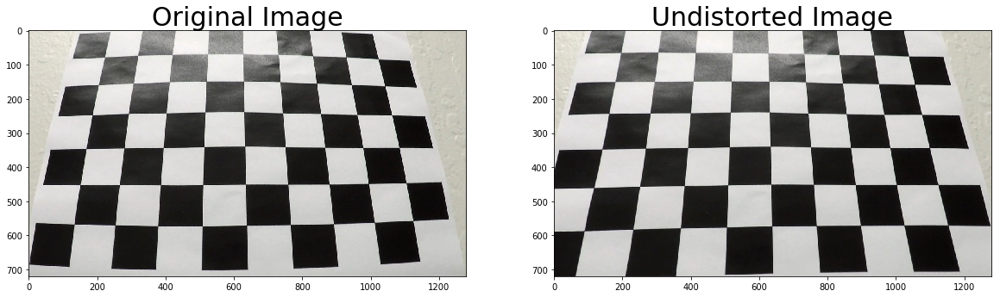

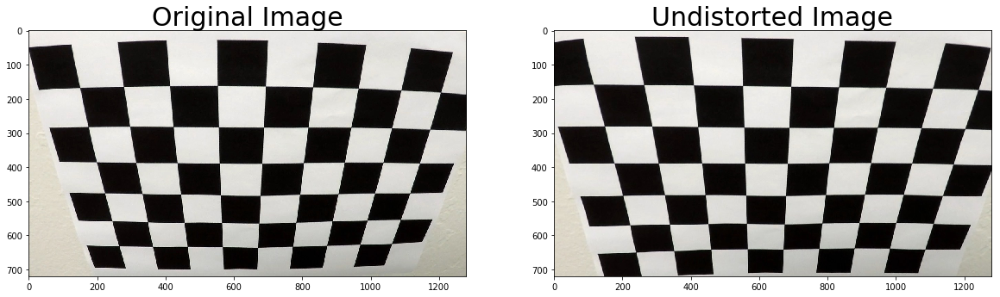

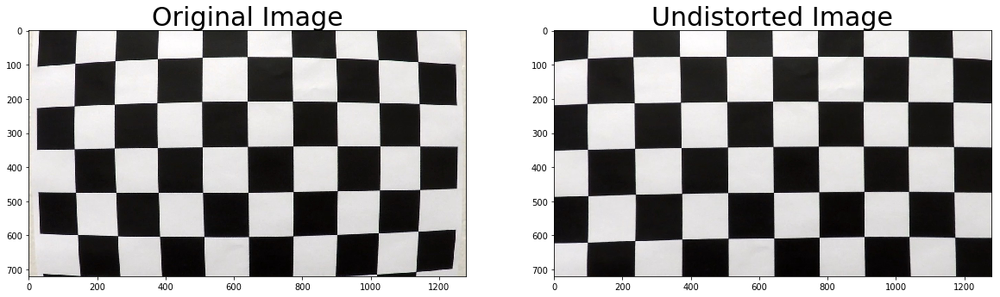

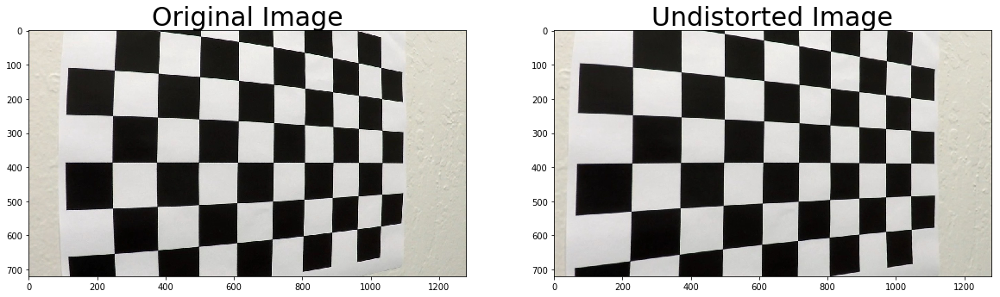

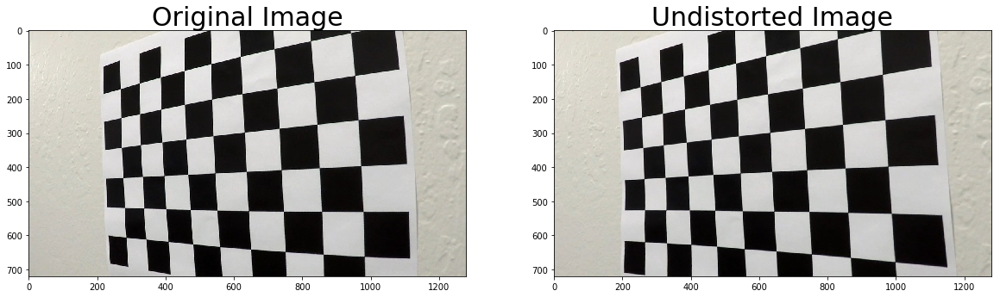

In [2]:
"""
Undistort the images
"""

import pickle
import os
%matplotlib inline

def undistort(mtx, dist, img_in_path, img_out_path='', plot=False):
    # Test undistortion on an image
    img = cv2.imread(img_in_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_size = (img.shape[1], img.shape[0])
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    if img_out_path:
        cv2.imwrite(img_out_path,dst)
    
    if plot:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
        ax1.imshow(img)
        ax1.set_title('Original Image', fontsize=30)
        ax2.imshow(dst)
        ax2.set_title('Undistorted Image', fontsize=30)
    return dst

image_in_folder = 'camera_cal/'
image_out_folder = 'camera_cal_output/'
files = [x for x in os.listdir(image_in_folder) if x.endswith('.jpg')]
chessboard_undists = []
for file in files:
    chessboard_undists.append(undistort(mtx,dist,
                              os.path.join(image_in_folder,file),
                              os.path.join(image_out_folder,file),
                              plot=True))

### Perspective transform
To convert perspective of the image to "bird's eye view". We need to define the source and target points on the image. In the chess board case, we could simply take advantage of the *findChessboardCorners()* function in cv2 to automatically define the source coner points. The following code shows how I tranform the perspective of the chess board image.

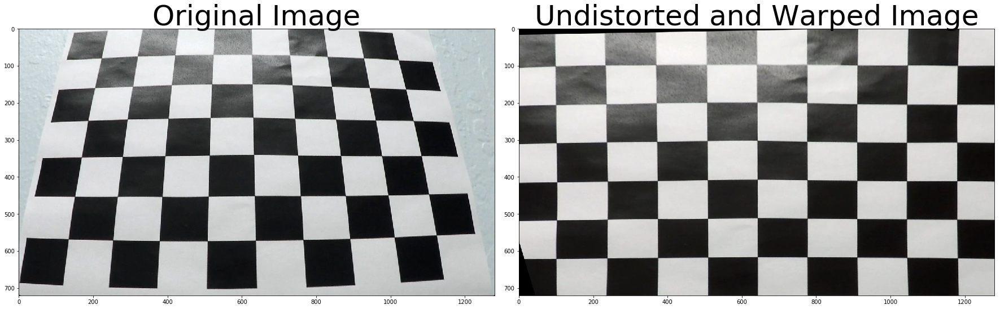

In [3]:
"""
Transform image perspective
"""

def corners_unwarp(img, nx, ny, mtx, dist):
    img_size = (img.shape[1], img.shape[0])
    img1 = cv2.undistort(img, mtx, dist, None, mtx)
    img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
    ret, corners = cv2.findChessboardCorners(img1, (nx, ny), None)
    warped,M = None,None
    if ret == True:
        src = np.float32([corners[0][0],corners[nx-1][0],corners[-1][0],corners[-nx][0]])
        offset = 100 # offset for dst points
        dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
                                 [img_size[0]-offset, img_size[1]-offset], 
                                 [offset, img_size[1]-offset]])
        M = cv2.getPerspectiveTransform(src, dst)
        warped = cv2.warpPerspective(img1, M, img_size, flags=cv2.INTER_LINEAR)
    else:
        raise Exception("Can't find given number of corners in the images")
    return warped, M


nx = 9
ny = 6

img = cv2.imread(os.path.join(image_in_folder,files[0]))
top_down, perspective_M = corners_unwarp(img, nx, ny, mtx, dist)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(top_down)
ax2.set_title('Undistorted and Warped Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

But in the case of lane finding, there is no corners like chessboard so we need to define our own source and target points. Assuming the ground is flat, I selected a trapozoidal shape in the image as the source points and a rectangle shape as the target points.

In [4]:
# X,Y
img_size = (1280, 720)
# Define conversions in x and y from pixels space to meters
ym_per_pix = 20/720 # meters per pixel in y dimension
xm_per_pix = 2.75/700 # meters per pixel in x dimension
            
# MMa 2017-06-27 Why it failed immediately when top source points are less then half of the height ??!
src = np.float32([ [img_size[0]/2-116,img_size[1]/2+150],
                    [img_size[0]/2+116,img_size[1]/2+150],
                    [img_size[0]/2+320,img_size[1]],
                    [img_size[0]/2-320,img_size[1]]])

offset_x = 300 # offset for dst points
offset_y = 400
dst = np.float32([ [offset_x, offset_y], 
                    [img_size[0]-offset_x, offset_y], 
                    [img_size[0]-offset_x, img_size[1]], 
                    [offset_x, img_size[1]]])

M = cv2.getPerspectiveTransform(src, dst)
M_inv = cv2.getPerspectiveTransform(dst, src)
ploty = np.linspace(0, img_size[1]-1, img_size[1]/10 )

/home/mma/miniconda3/envs/carnd-term1-cpu/lib/python3.5/site-packages/ipykernel_launcher.py:22: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.


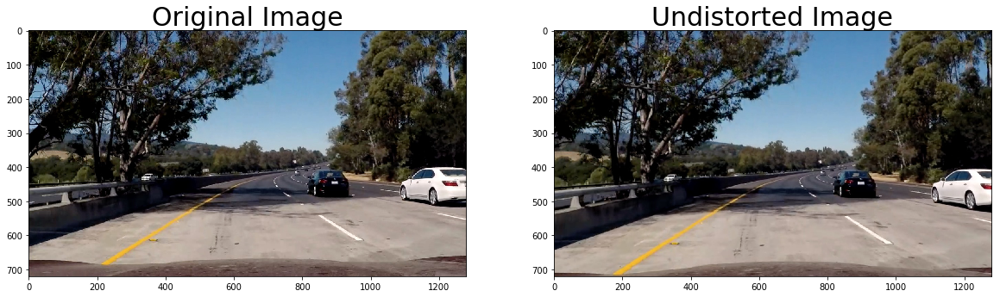

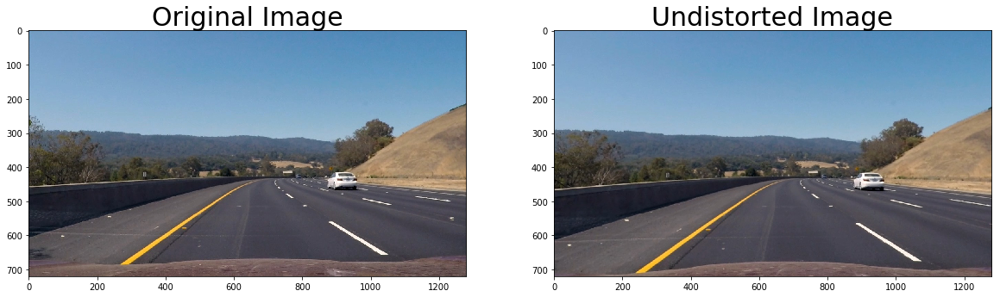

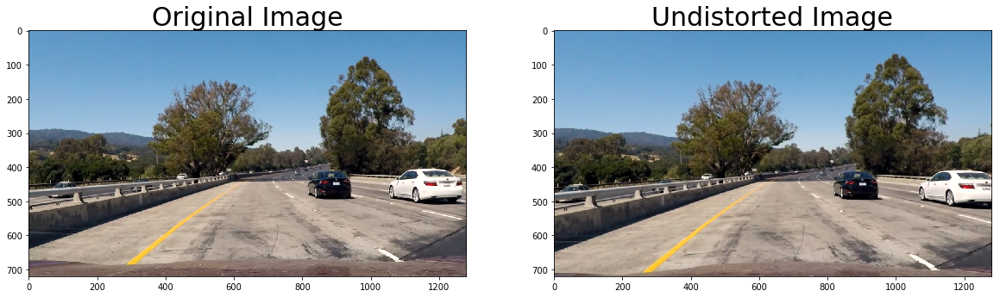

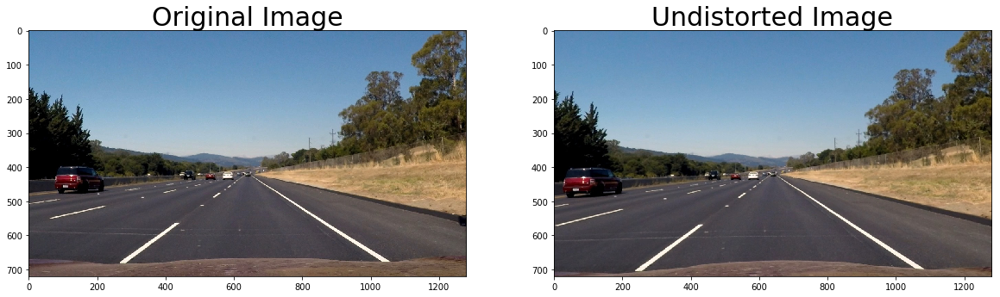

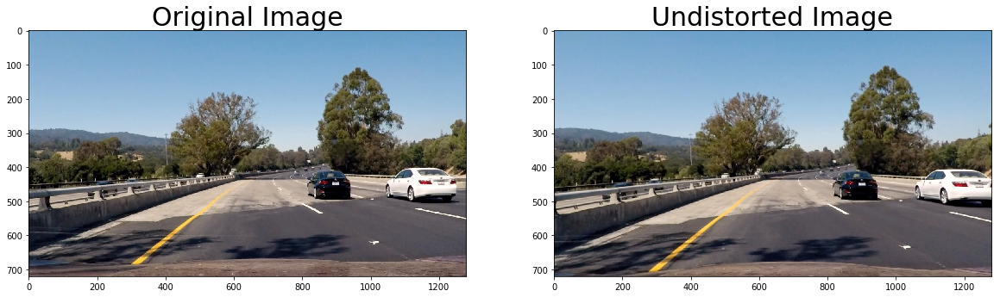

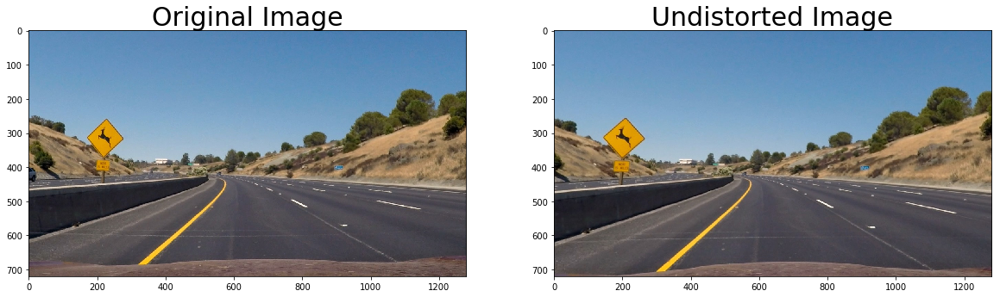

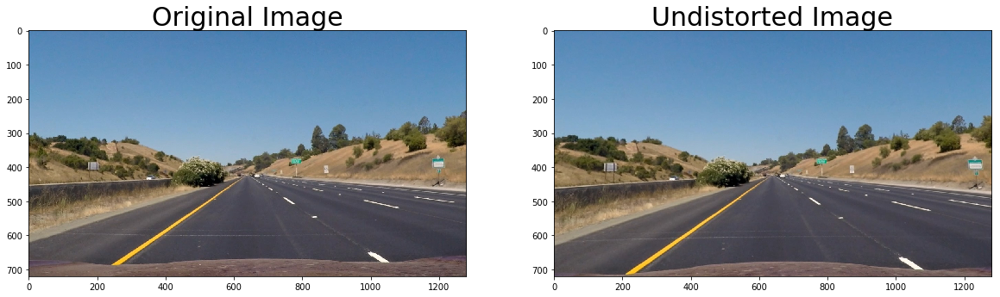

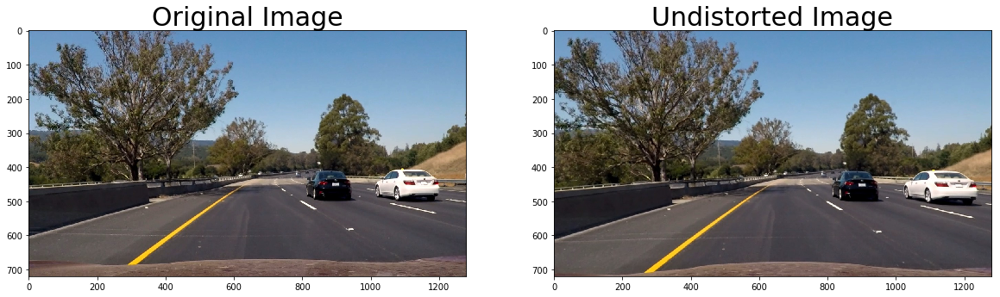

In [5]:
image_in_folder = 'test_images/'
files = [x for x in os.listdir(image_in_folder) if x.endswith('.jpg')]
images = []
for file in files:
    images.append(undistort(mtx,dist,
                            os.path.join(image_in_folder,file),
                            plot = True))

There are many ways to generate a thresholded binary images. Here I first use a gaunssian filter to blur the image and smooth the noise. Then I use sobel operator to find the horizontal edge of the image as lanes are mostly vertical. I also converted the image to HLS space and extract the saturation layer. It works really well for yellow lines because they are high in saturation. I also use the magnitude and direction of gradient to find the edge of the lanes. Finally, I combine three of these approaches and generate a binary image for lane extraction. The following picture shows the result of binary image generation as well as perspective transformation. 

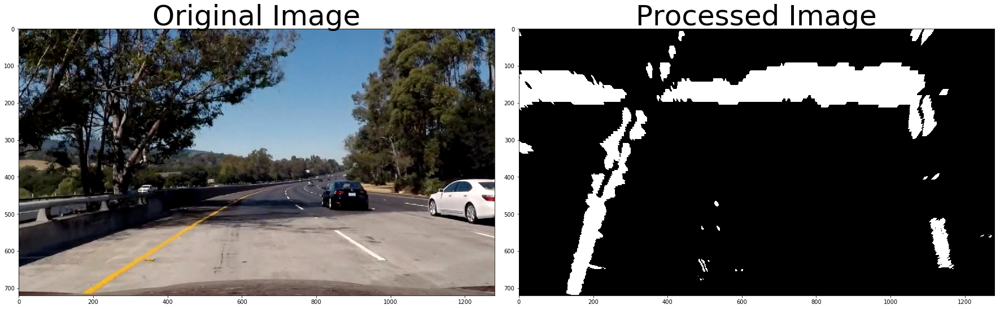

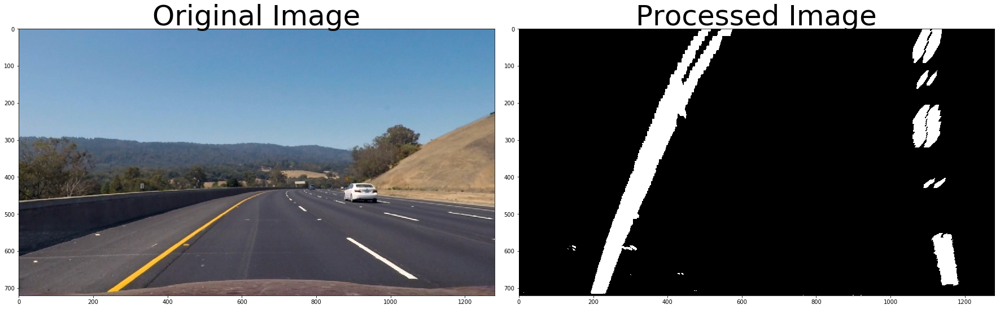

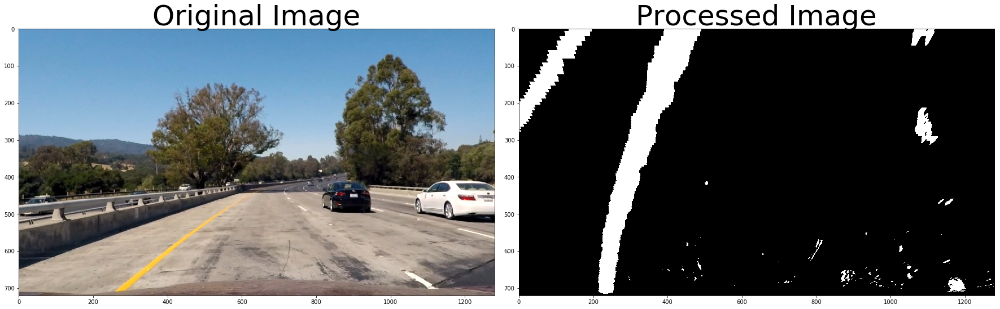

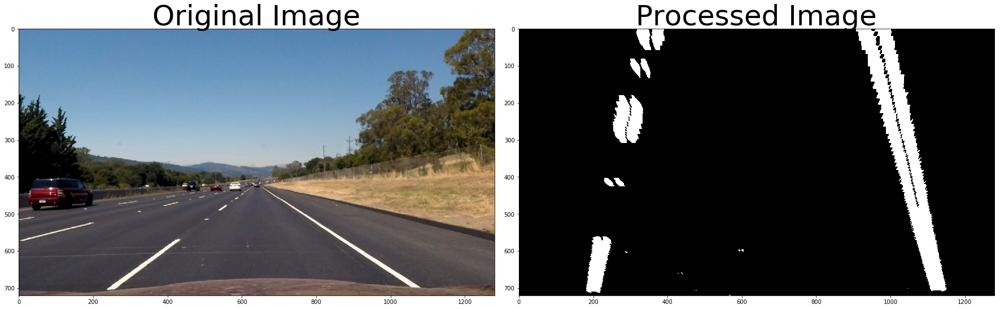

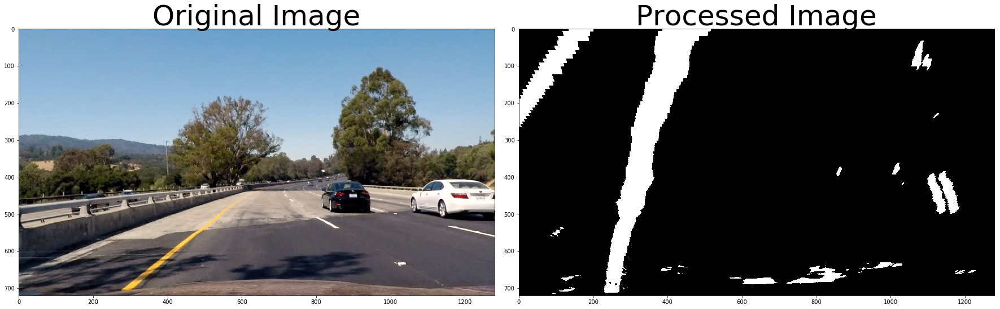

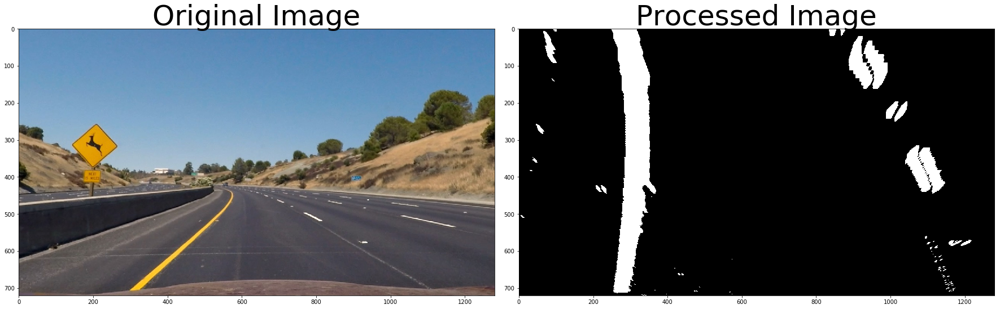

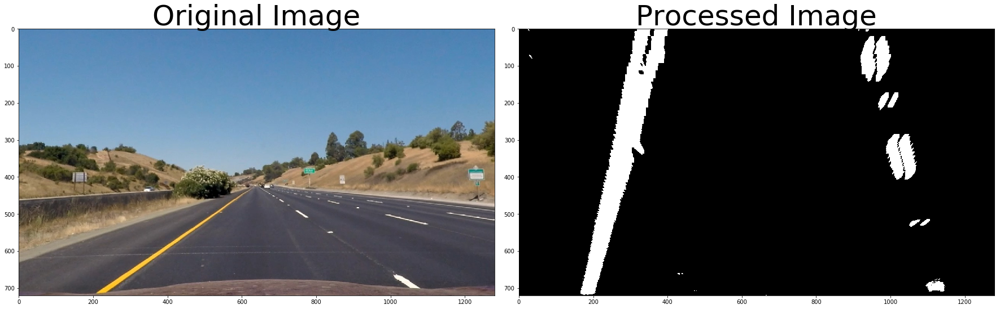

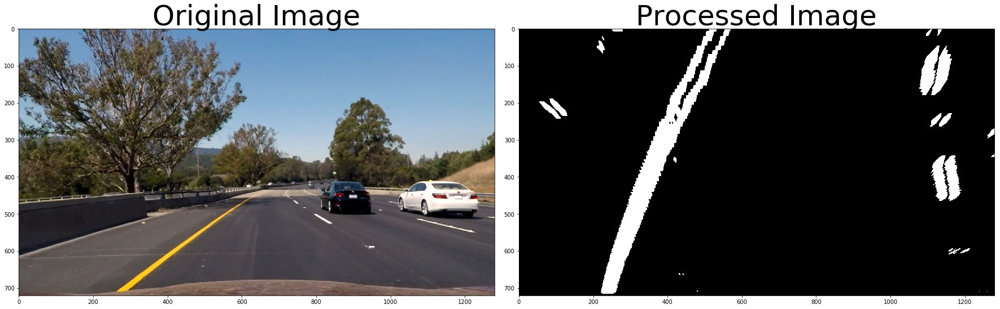

In [6]:
import utils
def select(img):
    filtered = utils.gaussian_blur(img,9)
    s = utils.hls_select(filtered,thresh=(100, 255))
    
    grad_x= utils.abs_sobel_thresh(filtered, 'x',thresh=(32, 255))
    grad_y= utils.abs_sobel_thresh(filtered, 'y',thresh=(32, 255))
    
    dir_bin = utils.dir_thresh(filtered,15, thresh=(0.63, 1.))
    mag_bin = utils.mag_thresh(filtered,15, thresh=(70, 78))

    combined = np.zeros_like(mag_bin)
    combined[((grad_x == 1) ) | 
             ((mag_bin == 1) & (dir_bin == 1)) |
             s > 0] = 1
    
    return combined

for img in images:
    img_bin = select(img)
    warped = cv2.warpPerspective(img_bin, M, img_size, flags=cv2.INTER_LINEAR)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(warped,cmap='gray')
    ax2.set_title('Processed Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

    plt.show()

In [7]:
import utils

def poly_fit(img):
    print("Initial search")
    histogram = np.sum(img[int(img.shape[0]/2):,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((img, img, img))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines

    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
#     print("left base {},right base {}".format(leftx_base,rightx_base))

    # Choose the number of sliding windows
    nwindows = 10
    # Set height of windows
    window_height = np.int(img.shape[0]/nwindows)
#     print("Using window height {}".format(window_height))

    # Identify the x and y positions of all nonzero pixels in the image
    nonzero  = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = img.shape[0] - (window+1)*window_height
        win_y_high = img.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin

#         # Draw the windows on the visualization image
#         cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 3) 
#         cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 3) 

        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                          (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                           (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]

        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)

        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit,right_fit = None,None
    if lefty.any() and leftx.any():
        left_fit = np.polyfit(lefty, leftx, 2)
    if righty.any() and rightx.any():
        right_fit = np.polyfit(righty, rightx, 2)
#     print(left_fit)
#     print(right_fit)
    return left_fit, right_fit


def poly_fit_update(img, left_fit, right_fit):
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & 
                     (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & 
                        (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit a second order polynomial to each
    left_fit,right_fit = None,None
    if lefty.any() and leftx.any():
        left_fit = np.polyfit(lefty, leftx, 2)
    if righty.any() and rightx.any():
        right_fit = np.polyfit(righty, rightx, 2)
    return left_fit, right_fit

ym_per_pix = 15/720 # meters per pixel in y dimension
xm_per_pix = 2.5/700 # meters per pixel in x dimension
def curvature(poly_fit,y_eval):
    return ((1 +(2*poly_fit[0]*y_eval*ym_per_pix + poly_fit[1])**2)**1.5) / np.absolute(2*poly_fit[0])

def draw_lane(img,ploty,left_fitx,right_fitx):
    img_new = img.copy()
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(img).astype(np.uint8)
    color_warp = warp_zero #np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, M_inv, (img.shape[1], img.shape[0])) 
    
    # Combine the result with the original image
    img_new = cv2.addWeighted(img_new, 1, newwarp, 0.3, 0)
    return img_new

def draw_info(img, curv_l, curv_r, dist_l,dist_r):
    img_new = np.copy(img)
    h = img_new.shape[0]
    font = cv2.FONT_HERSHEY_SIMPLEX
    text = 'Curvature Left : {:4.2f}'.format(curv_l) + 'm'
    cv2.putText(img_new, text, (40,70), font, 1, (255,255,255), 2, cv2.LINE_AA)
    text = 'Curvature right : {:4.2f}'.format(curv_r) + 'm'
    
    mean_dist = (dist_l +dist_r)/2
#     print(dist_l +dist_r)
    deviation = ((dist_l - mean_dist) + (mean_dist - dist_r))/2
    cv2.putText(img_new, text, (40,100), font, 1, (255,255,255), 2, cv2.LINE_AA)
    text = 'Deviation to center : {:4.2f}'.format(deviation) + 'm'
    cv2.putText(img_new, text, (40,130), font, 1, (255,255,255), 2, cv2.LINE_AA)
    return img_new
def get_poly_point(poly,x):
    return poly[0]*x*x+poly[1]*x+poly[2]

I define a Line class to store the information of each frame. In each update, I add the new detection into the previous detection and fuse them together to filter out the bad detections and make the result more stable. The method I use is basically a moving average filter. I use a threshold to determine if a new detection is good or bad. If it is good then I update the value with larger weight, if not, then update with smaller weight. The threshold is determined by running the the pipeline without any filtering and calculating the mean polynomial fit coefficient values.

|scenario | Mean polynomial coefficients |
--- | ---
|**curve road** 	L 	|	[  1.18180920e-05   7.80891282e-03   1.51736282e+00]
|        	R 	|	[  4.46696746e-05   3.21652172e-02   7.67916775e+00]
|**straight road** 	L 	|	[  7.57506233e-06   7.05633821e-03   3.65587183e+00]
|             	    R 	|	[  3.13976960e-05   2.05890272e-02   5.05038335e+00]
|**different round** 	L 	|	[  2.59277283e-05   2.85054620e-02   1.19792455e+01]
| 				    R 	|	[  5.60560312e-05   3.47728916e-02   8.93921383e+00]
|**shadow road** 	L 	|	[  3.52839926e-05   3.00916186e-02   1.03260225e+01]
| 				    R 	|	[  1.39808593e-04   1.25237837e-01   3.13900015e+01]

In [8]:
# Define a class to receive the characteristics of each line detection

class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.momemtum = 0.4 
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        self.diffs_sum = np.array([0,0,0], dtype='float') 
        self.test_count = 0
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
        
    def add_poly_fit(self,poly_fit):
#         print("poly_fit",poly_fit)
        if poly_fit == None:
            self.detected = False
        else:
            self.detected = True
            
            if self.best_fit == None:
                self.best_fit = poly_fit
                
            self.diffs = abs(poly_fit - self.best_fit)
            self.diffs_sum = self.diffs_sum + self.diffs
            self.test_count = self.test_count +1
#             print(self.diffs)
            if self.diffs[0] > 1.4e-04 or self.diffs[1] > 1.0e-01 or self.diffs[2] > 20. :
                self.detected = False
                momemtum = self.momemtum * 0.2
#                 print("bad detection",self.diffs)
            else:
                momemtum = self.momemtum
                
            self.best_fit[0] = self.best_fit[0]*(1-momemtum) + poly_fit[0]*momemtum
            self.best_fit[1] = self.best_fit[1]*(1-momemtum) + poly_fit[1]*momemtum
            self.best_fit[2] = self.best_fit[2]*(1-momemtum) + poly_fit[2]*momemtum
#                 print("self.current_fit ",self.current_fit)
    
            # Define y-value where we want radius of curvature
            # I'll choose the maximum y-value, corresponding to the bottom of the image
            y_eval = np.max(ploty)
            self.line_base_pos = abs(get_poly_point(self.best_fit, y_eval)-img_size[0]/2) * xm_per_pix

            # Calculate the new radii of curvature
            self.radius_of_curvature = curvature(self.best_fit,y_eval)

    def mean_diff(self):
        return self.diffs_sum/self.test_count

After all the basic function blocks were built I started to assembled the pipeline. Here are the steps in the pipeline:

1. Undistort the image
2. Binarize the image
3. Transform the image to bird's eye view
4. Use search window and histogram to find the lane pixels
5. Use polynomial fitting algorithm to fit the lane line
6. Calculate the curvature
7. Unwarp the perspective and draw the information

In [12]:
def pipeline(img):
    undistort = cv2.undistort(img, mtx, dist, None, mtx)
    img_bin = select(undistort)
    warped = cv2.warpPerspective(img_bin, M, img_size, flags=cv2.INTER_LINEAR)
    
    if l_line.best_fit == None or r_line.best_fit == None:
        left_fit,right_fit = poly_fit(warped)
    else:
        left_fit,right_fit = poly_fit_update(warped,l_line.best_fit,r_line.best_fit)
     
    l_line.add_poly_fit(left_fit)
    r_line.add_poly_fit(right_fit)
    
    
    # Generate x and y values for plotting
    left_fitx = l_line.best_fit[0]*ploty**2 + l_line.best_fit[1]*ploty + l_line.best_fit[2]
    right_fitx = r_line.best_fit[0]*ploty**2 + r_line.best_fit[1]*ploty + r_line.best_fit[2]
    
    result = draw_lane(undistort,ploty,left_fitx,right_fitx)
    result = draw_info(result,l_line.radius_of_curvature,r_line.radius_of_curvature,
                       l_line.line_base_pos,r_line.line_base_pos)
    return result

def pipeline_resized(img):
    result = pipeline(img)
    return cv2.resize(result, (320, 180))

# img_bin = select(images[0])
# warped = cv2.warpPerspective(img_bin, M, img_size, flags=cv2.INTER_LINEAR)
# f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
# f.tight_layout()
# ax1.imshow(img_bin,cmap='gray')
# ax1.set_title('Original Image', fontsize=50)
# ax2.imshow(warped,cmap='gray')
# ax2.set_title('Processed Image', fontsize=50)
# plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# plt.show()

Initial search


/home/mma/miniconda3/envs/carnd-term1-cpu/lib/python3.5/site-packages/ipykernel_launcher.py:30: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


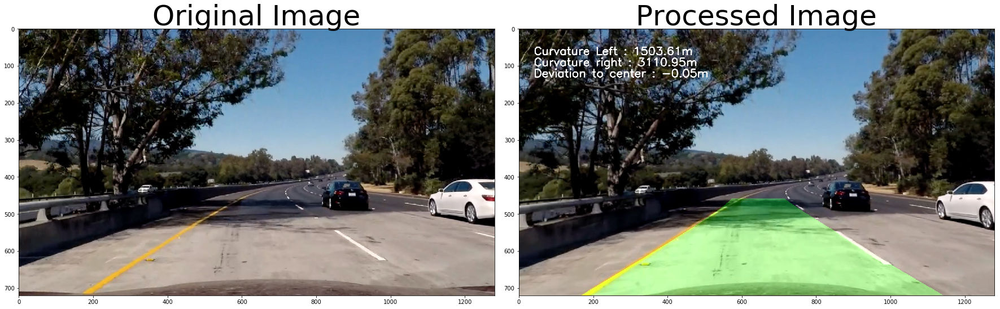

/home/mma/miniconda3/envs/carnd-term1-cpu/lib/python3.5/site-packages/ipykernel_launcher.py:6: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.
  
/home/mma/miniconda3/envs/carnd-term1-cpu/lib/python3.5/site-packages/ipykernel_launcher.py:35: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


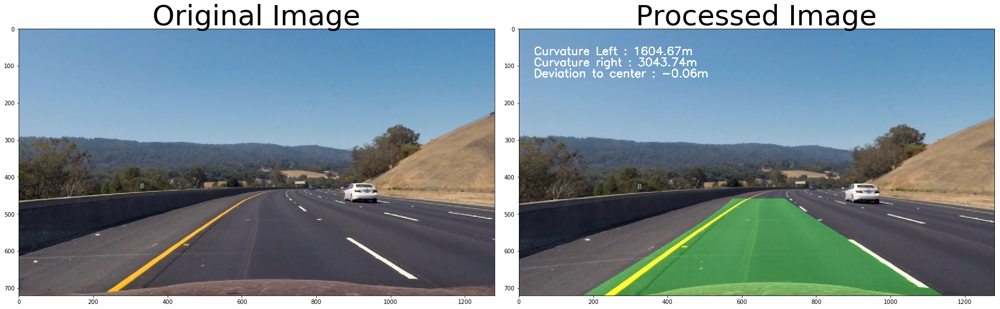

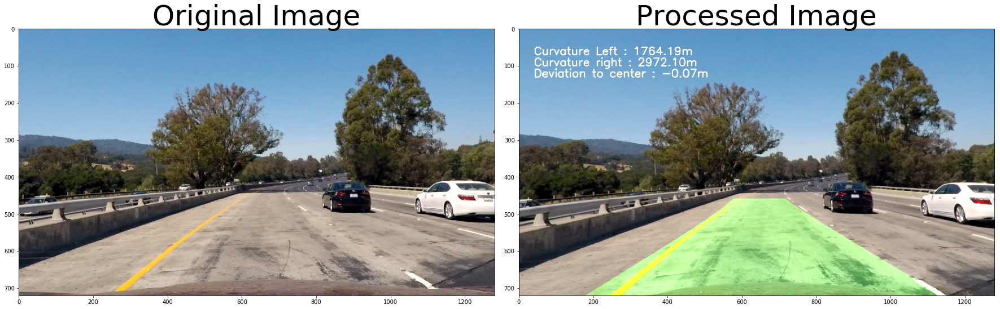

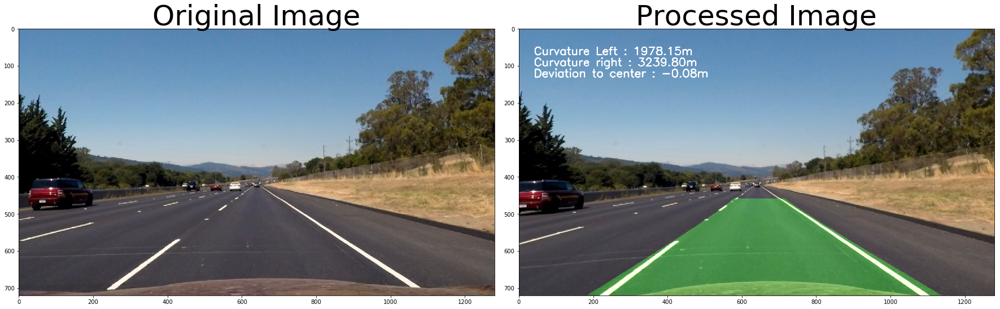

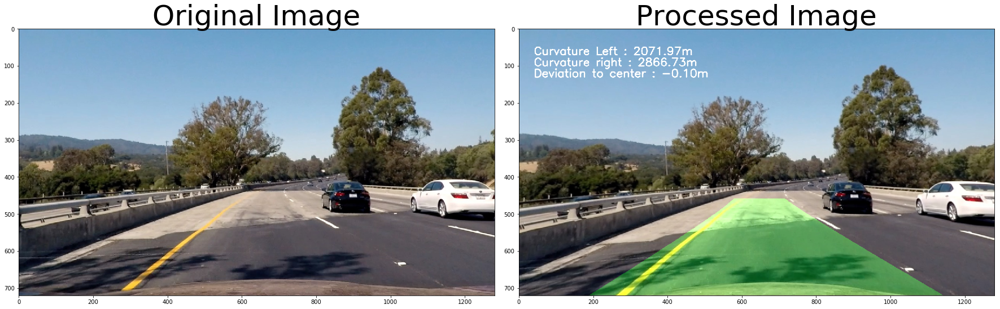

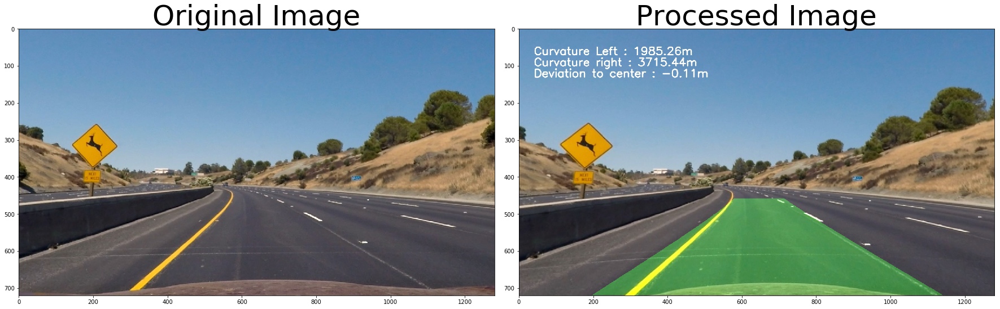

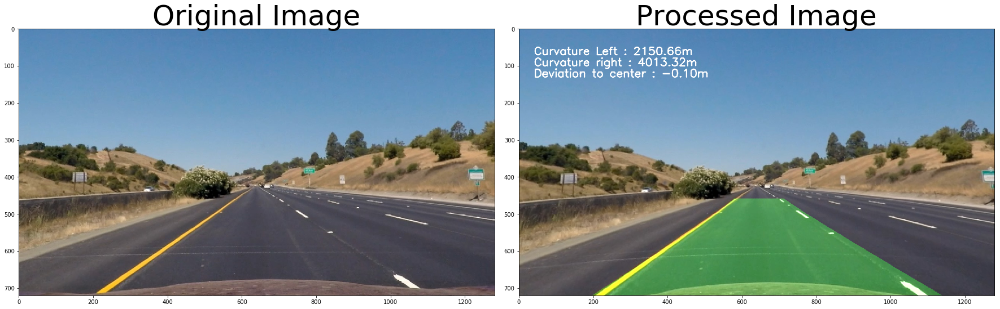

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [10]:
l_line = Line()
r_line = Line()
for image in images:
    image_new = pipeline(image)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(image_new)
    ax2.set_title('Processed Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    plt.show()
    
print(l_line.mean_diff())
print(r_line.mean_diff())

In [11]:
# ym_per_pix = 15/720,xm_per_pix = 2.5/700
print( ym_per_pix,xm_per_pix)

0.020833333333333332 0.0035714285714285713


In [50]:
from moviepy.editor import VideoFileClip
l_line = Line()
r_line = Line()
video_output = 'project_video_output.mp4'
video_input = VideoFileClip('project_video.mp4')
processed_video = video_input.fl_image(pipeline)
processed_video.write_videofile(video_output, audio=False)

Initial search
3.77568612037
[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


  0%|          | 1/1261 [00:00<07:20,  2.86it/s]

3.75013649338


  0%|          | 2/1261 [00:00<07:33,  2.78it/s]

3.73793372768


  0%|          | 3/1261 [00:01<07:25,  2.82it/s]

3.74192591523


  0%|          | 4/1261 [00:01<07:26,  2.82it/s]

3.75228466539


  0%|          | 5/1261 [00:01<07:34,  2.77it/s]

3.76279354849


  0%|          | 6/1261 [00:02<07:19,  2.86it/s]

3.7645597903


  1%|          | 7/1261 [00:02<07:15,  2.88it/s]

3.76444468508


  1%|          | 8/1261 [00:02<07:29,  2.79it/s]

3.79113289279


  1%|          | 9/1261 [00:03<07:14,  2.88it/s]

3.7964721065


  1%|          | 10/1261 [00:03<07:05,  2.94it/s]

3.79887635605


  1%|          | 11/1261 [00:03<07:08,  2.91it/s]

3.79708119847


  1%|          | 12/1261 [00:04<07:12,  2.89it/s]

3.79813610201


  1%|          | 13/1261 [00:04<07:12,  2.89it/s]

3.78429842929


  1%|          | 14/1261 [00:04<07:10,  2.90it/s]

3.77562500504


  1%|          | 15/1261 [00:05<07:25,  2.80it/s]

3.76672726359


  1%|▏         | 16/1261 [00:05<07:25,  2.79it/s]

3.75751304197


  1%|▏         | 17/1261 [00:05<07:25,  2.80it/s]

3.75565215288


  1%|▏         | 18/1261 [00:06<07:26,  2.78it/s]

3.75248199973


  2%|▏         | 19/1261 [00:06<07:19,  2.83it/s]

3.73555518711


  2%|▏         | 20/1261 [00:07<07:07,  2.90it/s]

3.72485134438


  2%|▏         | 21/1261 [00:07<07:11,  2.87it/s]

3.7228437229


  2%|▏         | 22/1261 [00:07<07:01,  2.94it/s]

3.72741592229


  2%|▏         | 23/1261 [00:08<06:57,  2.96it/s]

3.72451760807


  2%|▏         | 24/1261 [00:08<06:46,  3.04it/s]

3.72833077246


  2%|▏         | 25/1261 [00:08<06:42,  3.07it/s]

3.73242423578


  2%|▏         | 26/1261 [00:08<06:39,  3.09it/s]

3.73914127622


  2%|▏         | 27/1261 [00:09<06:33,  3.14it/s]

3.74756726444


  2%|▏         | 28/1261 [00:09<06:35,  3.12it/s]

3.75636376767


  2%|▏         | 29/1261 [00:09<06:35,  3.11it/s]

3.764532654


  2%|▏         | 30/1261 [00:10<06:37,  3.10it/s]

3.77957285718


  2%|▏         | 31/1261 [00:10<06:44,  3.04it/s]

3.79368034644


  3%|▎         | 32/1261 [00:10<06:51,  2.99it/s]

3.79950658161


  3%|▎         | 33/1261 [00:11<07:07,  2.87it/s]

3.81066985615


  3%|▎         | 34/1261 [00:11<07:25,  2.75it/s]

3.82233458731


  3%|▎         | 35/1261 [00:12<07:17,  2.80it/s]

3.82928260124


  3%|▎         | 36/1261 [00:12<07:29,  2.72it/s]

3.81895926296


  3%|▎         | 37/1261 [00:12<07:29,  2.73it/s]

3.80724182739


  3%|▎         | 38/1261 [00:13<07:26,  2.74it/s]

3.78994904132


  3%|▎         | 39/1261 [00:13<07:20,  2.77it/s]

3.77738447541


  3%|▎         | 40/1261 [00:13<07:29,  2.72it/s]

3.769567061


  3%|▎         | 41/1261 [00:14<07:35,  2.68it/s]

3.763967199


  3%|▎         | 42/1261 [00:14<08:18,  2.45it/s]

3.75911088095


  3%|▎         | 43/1261 [00:15<08:32,  2.38it/s]

3.75712547954


  3%|▎         | 44/1261 [00:15<08:06,  2.50it/s]

3.75788626566


  4%|▎         | 45/1261 [00:15<07:58,  2.54it/s]

3.76159227817


  4%|▎         | 46/1261 [00:16<08:03,  2.51it/s]

3.77410381323


  4%|▎         | 47/1261 [00:16<08:18,  2.43it/s]

3.77374521317


  4%|▍         | 48/1261 [00:17<08:36,  2.35it/s]

3.77062517676


  4%|▍         | 49/1261 [00:17<08:41,  2.32it/s]

3.76562734211


  4%|▍         | 50/1261 [00:18<08:50,  2.28it/s]

3.75609768282


  4%|▍         | 51/1261 [00:18<08:18,  2.43it/s]

3.74427509836


  4%|▍         | 52/1261 [00:18<08:03,  2.50it/s]

3.7323753458


  4%|▍         | 53/1261 [00:19<07:52,  2.55it/s]

3.72309605291


  4%|▍         | 54/1261 [00:19<07:55,  2.54it/s]

3.71811459256


  4%|▍         | 55/1261 [00:20<08:37,  2.33it/s]

3.71836681554


  4%|▍         | 56/1261 [00:20<09:28,  2.12it/s]

3.72074170491


  5%|▍         | 57/1261 [00:21<09:10,  2.19it/s]

3.72379594855


  5%|▍         | 58/1261 [00:21<08:58,  2.23it/s]

3.72754622141


  5%|▍         | 59/1261 [00:22<08:57,  2.24it/s]

3.73581016078


  5%|▍         | 60/1261 [00:22<08:24,  2.38it/s]

3.72631233045


  5%|▍         | 61/1261 [00:22<07:48,  2.56it/s]

3.72492324152


  5%|▍         | 62/1261 [00:23<07:30,  2.66it/s]

3.72498500043


  5%|▍         | 63/1261 [00:23<07:15,  2.75it/s]

3.70432404357


  5%|▌         | 64/1261 [00:23<07:12,  2.77it/s]

3.70741556257


  5%|▌         | 65/1261 [00:24<07:02,  2.83it/s]

3.71324250097


  5%|▌         | 66/1261 [00:24<06:45,  2.95it/s]

3.72223744474


  5%|▌         | 67/1261 [00:24<06:45,  2.94it/s]

3.72479610265


  5%|▌         | 68/1261 [00:25<06:51,  2.90it/s]

3.73165135956


  5%|▌         | 69/1261 [00:25<06:52,  2.89it/s]

3.7316714387


  6%|▌         | 70/1261 [00:25<06:47,  2.92it/s]

3.73402879078


  6%|▌         | 71/1261 [00:26<06:50,  2.90it/s]

3.73748457783


  6%|▌         | 72/1261 [00:26<06:49,  2.90it/s]

3.72343596023


  6%|▌         | 73/1261 [00:26<06:43,  2.95it/s]

3.69148805372


  6%|▌         | 74/1261 [00:27<06:41,  2.96it/s]

3.68210478571


  6%|▌         | 75/1261 [00:27<06:33,  3.01it/s]

3.6767963283


  6%|▌         | 76/1261 [00:27<06:38,  2.97it/s]

3.66636091524


  6%|▌         | 77/1261 [00:28<06:42,  2.94it/s]

3.66179989997


  6%|▌         | 78/1261 [00:28<06:38,  2.97it/s]

3.65308259253


  6%|▋         | 79/1261 [00:28<06:56,  2.84it/s]

3.66156213267


  6%|▋         | 80/1261 [00:29<07:11,  2.73it/s]

3.67791960548


  6%|▋         | 81/1261 [00:29<07:07,  2.76it/s]

3.69440261154


  7%|▋         | 82/1261 [00:29<07:04,  2.78it/s]

3.71118345813


  7%|▋         | 83/1261 [00:30<06:51,  2.86it/s]

3.73442082043


  7%|▋         | 84/1261 [00:30<06:50,  2.87it/s]

3.75633942532


  7%|▋         | 85/1261 [00:31<06:58,  2.81it/s]

3.77627433655


  7%|▋         | 86/1261 [00:31<06:51,  2.86it/s]

3.80056816908


  7%|▋         | 87/1261 [00:31<06:43,  2.91it/s]

3.80816876832


  7%|▋         | 88/1261 [00:32<06:39,  2.93it/s]

3.80537298614


  7%|▋         | 89/1261 [00:32<06:49,  2.86it/s]

3.80392996414


  7%|▋         | 90/1261 [00:32<06:45,  2.89it/s]

3.80165748949


  7%|▋         | 91/1261 [00:33<06:35,  2.96it/s]

3.80236370323


  7%|▋         | 92/1261 [00:33<06:40,  2.92it/s]

3.79853946251


  7%|▋         | 93/1261 [00:33<06:32,  2.98it/s]

3.79162313709


  7%|▋         | 94/1261 [00:34<06:33,  2.96it/s]

3.78235340988


  8%|▊         | 95/1261 [00:34<06:34,  2.96it/s]

3.77322528628


  8%|▊         | 96/1261 [00:34<06:44,  2.88it/s]

3.75762945195


  8%|▊         | 97/1261 [00:35<06:51,  2.83it/s]

3.75327702836


  8%|▊         | 98/1261 [00:35<06:48,  2.85it/s]

3.74410733908


  8%|▊         | 99/1261 [00:35<06:43,  2.88it/s]

3.71412054868


  8%|▊         | 100/1261 [00:36<06:53,  2.81it/s]

3.68652213313


  8%|▊         | 101/1261 [00:36<07:07,  2.72it/s]

3.67247102882


  8%|▊         | 102/1261 [00:36<06:55,  2.79it/s]

3.64878505527


  8%|▊         | 103/1261 [00:37<07:03,  2.73it/s]

3.65213242837


  8%|▊         | 104/1261 [00:37<07:00,  2.75it/s]

3.66054777292


  8%|▊         | 105/1261 [00:38<06:56,  2.78it/s]

3.67379013026


  8%|▊         | 106/1261 [00:38<06:54,  2.78it/s]

3.67626779925


  8%|▊         | 107/1261 [00:38<06:55,  2.78it/s]

3.67990764782


  9%|▊         | 108/1261 [00:39<06:48,  2.82it/s]

3.68095064006


  9%|▊         | 109/1261 [00:39<06:48,  2.82it/s]

3.68219470513


  9%|▊         | 110/1261 [00:39<06:36,  2.90it/s]

3.68498721862


  9%|▉         | 111/1261 [00:40<06:38,  2.88it/s]

3.68779713167


  9%|▉         | 112/1261 [00:40<06:40,  2.87it/s]

3.69246497606


  9%|▉         | 113/1261 [00:40<06:36,  2.89it/s]

3.70371727496


  9%|▉         | 114/1261 [00:41<06:47,  2.82it/s]

3.6938126433


  9%|▉         | 115/1261 [00:41<06:59,  2.73it/s]

3.68725525079


  9%|▉         | 116/1261 [00:41<07:07,  2.68it/s]

3.68655701853


  9%|▉         | 117/1261 [00:42<07:03,  2.70it/s]

3.69428454398


  9%|▉         | 118/1261 [00:42<06:59,  2.72it/s]

3.70444030401


  9%|▉         | 119/1261 [00:43<06:40,  2.85it/s]

3.71084837038


 10%|▉         | 120/1261 [00:43<06:42,  2.83it/s]

3.711549823


 10%|▉         | 121/1261 [00:43<06:48,  2.79it/s]

3.71041287939


 10%|▉         | 122/1261 [00:44<06:33,  2.89it/s]

3.70503202067


 10%|▉         | 123/1261 [00:44<06:30,  2.92it/s]

3.6814664505


 10%|▉         | 124/1261 [00:44<06:35,  2.88it/s]

3.67117000311


 10%|▉         | 125/1261 [00:45<06:52,  2.75it/s]

3.66195949387


 10%|▉         | 126/1261 [00:45<07:02,  2.69it/s]

3.63941226955


 10%|█         | 127/1261 [00:45<07:20,  2.58it/s]

3.64215257596


 10%|█         | 128/1261 [00:46<07:03,  2.68it/s]

3.65519450651


 10%|█         | 129/1261 [00:46<06:59,  2.70it/s]

3.66694934331


 10%|█         | 130/1261 [00:47<06:53,  2.73it/s]

3.67775924131


 10%|█         | 131/1261 [00:47<06:49,  2.76it/s]

3.68704439715


 10%|█         | 132/1261 [00:47<06:47,  2.77it/s]

3.68902482413


 11%|█         | 133/1261 [00:48<06:48,  2.76it/s]

3.6908701962


 11%|█         | 134/1261 [00:48<06:37,  2.83it/s]

3.69030962315


 11%|█         | 135/1261 [00:48<06:43,  2.79it/s]

3.67799747953


 11%|█         | 136/1261 [00:49<06:44,  2.78it/s]

3.67293576134


 11%|█         | 137/1261 [00:49<06:42,  2.79it/s]

3.67255347123


 11%|█         | 138/1261 [00:49<06:43,  2.79it/s]

3.67183096067


 11%|█         | 139/1261 [00:50<06:47,  2.75it/s]

3.67296961234


 11%|█         | 140/1261 [00:50<06:48,  2.74it/s]

3.68269505543


 11%|█         | 141/1261 [00:50<06:46,  2.76it/s]

3.6984420846


 11%|█▏        | 142/1261 [00:51<06:35,  2.83it/s]

3.70966390923


 11%|█▏        | 143/1261 [00:51<06:26,  2.89it/s]

3.72000426241


 11%|█▏        | 144/1261 [00:51<06:26,  2.89it/s]

3.72467370808


 11%|█▏        | 145/1261 [00:52<06:31,  2.85it/s]

3.73141670851


 12%|█▏        | 146/1261 [00:52<06:31,  2.85it/s]

3.73337344618


 12%|█▏        | 147/1261 [00:53<06:26,  2.89it/s]

3.74072171051


 12%|█▏        | 148/1261 [00:53<06:34,  2.82it/s]

3.7290327645


 12%|█▏        | 149/1261 [00:53<06:25,  2.88it/s]

3.71895525369


 12%|█▏        | 150/1261 [00:54<06:31,  2.84it/s]

3.709774599


 12%|█▏        | 151/1261 [00:54<06:26,  2.87it/s]

3.70012459289


 12%|█▏        | 152/1261 [00:54<06:38,  2.78it/s]

3.6958019818


 12%|█▏        | 153/1261 [00:55<06:37,  2.78it/s]

3.68958270094


 12%|█▏        | 154/1261 [00:55<06:38,  2.78it/s]

3.69375305129


 12%|█▏        | 155/1261 [00:55<06:30,  2.83it/s]

3.70841272769


 12%|█▏        | 156/1261 [00:56<06:34,  2.80it/s]

3.71999635631


 12%|█▏        | 157/1261 [00:56<06:25,  2.86it/s]

3.72741305474


 13%|█▎        | 158/1261 [00:56<06:26,  2.85it/s]

3.72878125265


 13%|█▎        | 159/1261 [00:57<06:30,  2.82it/s]

3.75703344995


 13%|█▎        | 160/1261 [00:57<06:23,  2.87it/s]

3.77482915641


 13%|█▎        | 161/1261 [00:57<06:23,  2.87it/s]

3.79611653415


 13%|█▎        | 162/1261 [00:58<06:38,  2.76it/s]

3.79140435232


 13%|█▎        | 163/1261 [00:58<06:26,  2.84it/s]

3.77234538679


 13%|█▎        | 164/1261 [00:59<06:22,  2.87it/s]

3.75484213011


 13%|█▎        | 165/1261 [00:59<06:22,  2.87it/s]

3.75152171337


 13%|█▎        | 166/1261 [00:59<06:24,  2.85it/s]

3.75298723908


 13%|█▎        | 167/1261 [01:00<06:28,  2.82it/s]

3.75762837705


 13%|█▎        | 168/1261 [01:00<06:19,  2.88it/s]

3.76301229947


 13%|█▎        | 169/1261 [01:00<06:19,  2.87it/s]

3.76894851006


 13%|█▎        | 170/1261 [01:01<06:16,  2.90it/s]

3.7755370832


 14%|█▎        | 171/1261 [01:01<06:18,  2.88it/s]

3.76795994529


 14%|█▎        | 172/1261 [01:01<06:20,  2.86it/s]

3.74784574133


 14%|█▎        | 173/1261 [01:02<06:19,  2.87it/s]

3.72904396161


 14%|█▍        | 174/1261 [01:02<06:19,  2.86it/s]

3.72080899054


 14%|█▍        | 175/1261 [01:02<06:30,  2.78it/s]

3.7132908879


 14%|█▍        | 176/1261 [01:03<06:20,  2.85it/s]

3.70617170883


 14%|█▍        | 177/1261 [01:03<06:21,  2.84it/s]

3.7020567947


 14%|█▍        | 178/1261 [01:03<06:17,  2.87it/s]

3.70219869882


 14%|█▍        | 179/1261 [01:04<06:16,  2.88it/s]

3.70406880345


 14%|█▍        | 180/1261 [01:04<06:33,  2.74it/s]

3.72993440838


 14%|█▍        | 181/1261 [01:05<06:37,  2.72it/s]

3.75412593399


 14%|█▍        | 182/1261 [01:05<06:44,  2.67it/s]

3.7800562107


 15%|█▍        | 183/1261 [01:05<06:31,  2.76it/s]

3.80137868244


 15%|█▍        | 184/1261 [01:06<06:29,  2.77it/s]

3.8180835274


 15%|█▍        | 185/1261 [01:06<06:31,  2.75it/s]

3.8230337096


 15%|█▍        | 186/1261 [01:06<06:33,  2.73it/s]

3.82537401671


 15%|█▍        | 187/1261 [01:07<06:29,  2.76it/s]

3.8252381799


 15%|█▍        | 188/1261 [01:07<06:31,  2.74it/s]

3.82075810422


 15%|█▍        | 189/1261 [01:08<06:38,  2.69it/s]

3.81428044957


 15%|█▌        | 190/1261 [01:08<06:29,  2.75it/s]

3.80559740719


 15%|█▌        | 191/1261 [01:08<06:22,  2.80it/s]

3.79475910944


 15%|█▌        | 192/1261 [01:09<06:24,  2.78it/s]

3.78903147914


 15%|█▌        | 193/1261 [01:09<06:26,  2.76it/s]

3.77845431464


 15%|█▌        | 194/1261 [01:09<06:25,  2.77it/s]

3.76357835043


 15%|█▌        | 195/1261 [01:10<06:16,  2.83it/s]

3.74906055537


 16%|█▌        | 196/1261 [01:10<06:24,  2.77it/s]

3.74466753289


 16%|█▌        | 197/1261 [01:10<06:25,  2.76it/s]

3.74772696797


 16%|█▌        | 198/1261 [01:11<06:13,  2.85it/s]

3.75605861946


 16%|█▌        | 199/1261 [01:11<06:08,  2.88it/s]

3.76633186187


 16%|█▌        | 200/1261 [01:11<06:16,  2.81it/s]

3.77581225158


 16%|█▌        | 201/1261 [01:12<06:20,  2.79it/s]

3.7865078091


 16%|█▌        | 202/1261 [01:12<06:14,  2.83it/s]

3.79426089825


 16%|█▌        | 203/1261 [01:12<06:04,  2.90it/s]

3.79724843996


 16%|█▌        | 204/1261 [01:13<06:07,  2.87it/s]

3.80712476294


 16%|█▋        | 205/1261 [01:13<05:58,  2.94it/s]

3.81138450308


 16%|█▋        | 206/1261 [01:13<06:08,  2.86it/s]

3.81241361941


 16%|█▋        | 207/1261 [01:14<06:03,  2.90it/s]

3.80418614934


 16%|█▋        | 208/1261 [01:14<06:14,  2.81it/s]

3.7924415816


 17%|█▋        | 209/1261 [01:15<06:14,  2.81it/s]

3.79609105818


 17%|█▋        | 210/1261 [01:15<06:09,  2.85it/s]

3.8004883287


 17%|█▋        | 211/1261 [01:15<06:05,  2.87it/s]

3.80273958426


 17%|█▋        | 212/1261 [01:16<06:12,  2.82it/s]

3.80247137252


 17%|█▋        | 213/1261 [01:16<06:12,  2.81it/s]

3.78134742875


 17%|█▋        | 214/1261 [01:16<06:13,  2.80it/s]

3.77094757147


 17%|█▋        | 215/1261 [01:17<06:08,  2.84it/s]

3.77743155032


 17%|█▋        | 216/1261 [01:17<06:12,  2.80it/s]

3.78855528505


 17%|█▋        | 217/1261 [01:17<06:13,  2.80it/s]

3.79585977037


 17%|█▋        | 218/1261 [01:18<06:13,  2.80it/s]

3.80057522967


 17%|█▋        | 219/1261 [01:18<06:04,  2.86it/s]

3.79698732067


 17%|█▋        | 220/1261 [01:18<05:59,  2.89it/s]

3.79690501785


 18%|█▊        | 221/1261 [01:19<06:04,  2.86it/s]

3.8150740154


 18%|█▊        | 222/1261 [01:19<05:59,  2.89it/s]

3.80841716853


 18%|█▊        | 223/1261 [01:19<06:04,  2.84it/s]

3.79897251961


 18%|█▊        | 224/1261 [01:20<06:00,  2.88it/s]

3.78670559901


 18%|█▊        | 225/1261 [01:20<05:59,  2.88it/s]

3.77462442439


 18%|█▊        | 226/1261 [01:21<06:09,  2.80it/s]

3.76635292618


 18%|█▊        | 227/1261 [01:21<06:03,  2.84it/s]

3.74230386117


 18%|█▊        | 228/1261 [01:21<06:08,  2.80it/s]

3.73103447235


 18%|█▊        | 229/1261 [01:22<06:13,  2.76it/s]

3.73038469564


 18%|█▊        | 230/1261 [01:22<06:03,  2.83it/s]

3.73348126775


 18%|█▊        | 231/1261 [01:22<06:00,  2.85it/s]

3.7319675535


 18%|█▊        | 232/1261 [01:23<05:59,  2.86it/s]

3.73207211418


 18%|█▊        | 233/1261 [01:23<05:55,  2.89it/s]

3.71053218628


 19%|█▊        | 234/1261 [01:23<05:56,  2.88it/s]

3.70582782362


 19%|█▊        | 235/1261 [01:24<06:00,  2.84it/s]

3.70606036819


 19%|█▊        | 236/1261 [01:24<06:04,  2.81it/s]

3.70759139285


 19%|█▉        | 237/1261 [01:24<06:05,  2.80it/s]

3.70482412606


 19%|█▉        | 238/1261 [01:25<05:53,  2.90it/s]

3.70488680124


 19%|█▉        | 239/1261 [01:25<05:53,  2.89it/s]

3.70773803679


 19%|█▉        | 240/1261 [01:25<06:01,  2.82it/s]

3.71259457083


 19%|█▉        | 241/1261 [01:26<05:59,  2.84it/s]

3.72214567809


 19%|█▉        | 242/1261 [01:26<05:59,  2.83it/s]

3.73870375727


 19%|█▉        | 243/1261 [01:27<06:03,  2.80it/s]

3.74902191769


 19%|█▉        | 244/1261 [01:27<06:12,  2.73it/s]

3.75715295027


 19%|█▉        | 245/1261 [01:27<06:13,  2.72it/s]

3.75793721573


 20%|█▉        | 246/1261 [01:28<06:02,  2.80it/s]

3.72801564912


 20%|█▉        | 247/1261 [01:28<06:11,  2.73it/s]

3.70747535521


 20%|█▉        | 248/1261 [01:28<06:08,  2.75it/s]

3.7084522381


 20%|█▉        | 249/1261 [01:29<06:16,  2.69it/s]

3.70136817949


 20%|█▉        | 250/1261 [01:29<06:06,  2.76it/s]

3.71079503746


 20%|█▉        | 251/1261 [01:29<05:59,  2.81it/s]

3.71911849263


 20%|█▉        | 252/1261 [01:30<05:52,  2.86it/s]

3.73108821088


 20%|██        | 253/1261 [01:30<06:06,  2.75it/s]

3.74634388311


 20%|██        | 254/1261 [01:31<06:01,  2.79it/s]

3.7514955398


 20%|██        | 255/1261 [01:31<05:56,  2.82it/s]

3.76103410484


 20%|██        | 256/1261 [01:31<05:58,  2.80it/s]

3.76816001001


 20%|██        | 257/1261 [01:32<05:56,  2.82it/s]

3.76365556856


 20%|██        | 258/1261 [01:32<06:01,  2.77it/s]

3.73223788957


 21%|██        | 259/1261 [01:32<06:00,  2.78it/s]

3.71154294354


 21%|██        | 260/1261 [01:33<06:03,  2.76it/s]

3.69693635724


 21%|██        | 261/1261 [01:33<06:07,  2.72it/s]

3.69046187399


 21%|██        | 262/1261 [01:33<06:02,  2.75it/s]

3.68647728846


 21%|██        | 263/1261 [01:34<05:56,  2.80it/s]

3.69822878682


 21%|██        | 264/1261 [01:34<06:00,  2.76it/s]

3.71724055209


 21%|██        | 265/1261 [01:34<05:54,  2.81it/s]

3.7366423364


 21%|██        | 266/1261 [01:35<05:47,  2.86it/s]

3.74531127535


 21%|██        | 267/1261 [01:35<05:48,  2.85it/s]

3.76657255274


 21%|██▏       | 268/1261 [01:35<05:45,  2.87it/s]

3.78328990465


 21%|██▏       | 269/1261 [01:36<05:40,  2.91it/s]

3.79055938903


 21%|██▏       | 270/1261 [01:36<05:35,  2.95it/s]

3.79876661043


 21%|██▏       | 271/1261 [01:36<05:33,  2.97it/s]

3.812801399


 22%|██▏       | 272/1261 [01:37<05:45,  2.86it/s]

3.80383732532


 22%|██▏       | 273/1261 [01:37<05:49,  2.83it/s]

3.78969821189


 22%|██▏       | 274/1261 [01:38<05:44,  2.86it/s]

3.78487592768


 22%|██▏       | 275/1261 [01:38<05:37,  2.92it/s]

3.78798936141


 22%|██▏       | 276/1261 [01:38<05:40,  2.89it/s]

3.79618007244


 22%|██▏       | 277/1261 [01:39<05:43,  2.86it/s]

3.80219857333


 22%|██▏       | 278/1261 [01:39<05:44,  2.85it/s]

3.8073535024


 22%|██▏       | 279/1261 [01:39<05:47,  2.83it/s]

3.80518838699


 22%|██▏       | 280/1261 [01:40<05:42,  2.86it/s]

3.79797084209


 22%|██▏       | 281/1261 [01:40<05:40,  2.88it/s]

3.79802367853


 22%|██▏       | 282/1261 [01:40<05:28,  2.98it/s]

3.7727950776


 22%|██▏       | 283/1261 [01:41<05:27,  2.99it/s]

3.76557732519


 23%|██▎       | 284/1261 [01:41<05:37,  2.89it/s]

3.74162316197


 23%|██▎       | 285/1261 [01:41<05:39,  2.88it/s]

3.73358289932


 23%|██▎       | 286/1261 [01:42<05:36,  2.89it/s]

3.73278228929


 23%|██▎       | 287/1261 [01:42<05:35,  2.90it/s]

3.74296450394


 23%|██▎       | 288/1261 [01:42<05:43,  2.83it/s]

3.74199230532


 23%|██▎       | 289/1261 [01:43<05:39,  2.86it/s]

3.76101587113


 23%|██▎       | 290/1261 [01:43<05:39,  2.86it/s]

3.77547737974


 23%|██▎       | 291/1261 [01:43<05:37,  2.88it/s]

3.78119274537


 23%|██▎       | 292/1261 [01:44<05:44,  2.81it/s]

3.7799843225


 23%|██▎       | 293/1261 [01:44<05:54,  2.73it/s]

3.78172542369


 23%|██▎       | 294/1261 [01:45<05:47,  2.79it/s]

3.75572869059


 23%|██▎       | 295/1261 [01:45<05:42,  2.82it/s]

3.73144444428


 23%|██▎       | 296/1261 [01:45<05:45,  2.79it/s]

3.71501597531


 24%|██▎       | 297/1261 [01:46<05:54,  2.72it/s]

3.71482021153


 24%|██▎       | 298/1261 [01:46<05:59,  2.68it/s]

3.71778649551


 24%|██▎       | 299/1261 [01:46<06:04,  2.64it/s]

3.72633194579


 24%|██▍       | 300/1261 [01:47<06:04,  2.63it/s]

3.74158612618


 24%|██▍       | 301/1261 [01:47<05:54,  2.70it/s]

3.75965497196


 24%|██▍       | 302/1261 [01:48<05:53,  2.71it/s]

3.7760839156


 24%|██▍       | 303/1261 [01:48<05:43,  2.79it/s]

3.78886142504


 24%|██▍       | 304/1261 [01:48<05:31,  2.89it/s]

3.79629007669


 24%|██▍       | 305/1261 [01:49<05:23,  2.96it/s]

3.8076467702


 24%|██▍       | 306/1261 [01:49<05:47,  2.75it/s]

3.84128918403


 24%|██▍       | 307/1261 [01:49<05:47,  2.74it/s]

3.8539390618


 24%|██▍       | 308/1261 [01:50<05:47,  2.74it/s]

3.83339466212


 25%|██▍       | 309/1261 [01:50<05:39,  2.80it/s]

3.81700350488


 25%|██▍       | 310/1261 [01:50<05:37,  2.82it/s]

3.81559394932


 25%|██▍       | 311/1261 [01:51<05:45,  2.75it/s]

3.80635058161


 25%|██▍       | 312/1261 [01:51<05:46,  2.74it/s]

3.79388629648


 25%|██▍       | 313/1261 [01:51<05:53,  2.68it/s]

3.77562650064


 25%|██▍       | 314/1261 [01:52<05:38,  2.80it/s]

3.76266293162


 25%|██▍       | 315/1261 [01:52<05:31,  2.85it/s]

3.75282409533


 25%|██▌       | 316/1261 [01:53<05:35,  2.82it/s]

3.74528596029


 25%|██▌       | 317/1261 [01:53<05:29,  2.87it/s]

3.74789832473


 25%|██▌       | 318/1261 [01:53<05:38,  2.79it/s]

3.73371189965


 25%|██▌       | 319/1261 [01:54<05:32,  2.83it/s]

3.72231677574


 25%|██▌       | 320/1261 [01:54<05:20,  2.93it/s]

3.69305146476


 25%|██▌       | 321/1261 [01:54<05:22,  2.91it/s]

3.67653184155


 26%|██▌       | 322/1261 [01:55<05:37,  2.78it/s]

3.67189151519


 26%|██▌       | 323/1261 [01:55<05:31,  2.83it/s]

3.67168705061


 26%|██▌       | 324/1261 [01:55<05:26,  2.87it/s]

3.67405793973


 26%|██▌       | 325/1261 [01:56<05:18,  2.94it/s]

3.67986225979


 26%|██▌       | 326/1261 [01:56<05:29,  2.84it/s]

3.68673184511


 26%|██▌       | 327/1261 [01:56<05:31,  2.82it/s]

3.69764027907


 26%|██▌       | 328/1261 [01:57<05:19,  2.92it/s]

3.70727315691


 26%|██▌       | 329/1261 [01:57<05:28,  2.83it/s]

3.72156180591


 26%|██▌       | 330/1261 [01:57<05:44,  2.70it/s]

3.72925724995


 26%|██▌       | 331/1261 [01:58<05:38,  2.74it/s]

3.71697449812


 26%|██▋       | 332/1261 [01:58<05:34,  2.78it/s]

3.71752732199


 26%|██▋       | 333/1261 [01:59<05:38,  2.74it/s]

3.72038032972


 26%|██▋       | 334/1261 [01:59<05:58,  2.59it/s]

3.73592089455


 27%|██▋       | 335/1261 [01:59<05:46,  2.67it/s]

3.7444991284


 27%|██▋       | 336/1261 [02:00<05:47,  2.66it/s]

3.75009100195


 27%|██▋       | 337/1261 [02:00<05:45,  2.67it/s]

3.75749826615


 27%|██▋       | 338/1261 [02:00<05:37,  2.74it/s]

3.75917517061


 27%|██▋       | 339/1261 [02:01<05:28,  2.81it/s]

3.75958714141


 27%|██▋       | 340/1261 [02:01<05:33,  2.76it/s]

3.75342550758


 27%|██▋       | 341/1261 [02:01<05:25,  2.83it/s]

3.75506204266


 27%|██▋       | 342/1261 [02:02<05:29,  2.79it/s]

3.7439603411


 27%|██▋       | 343/1261 [02:02<05:21,  2.86it/s]

3.7194049377


 27%|██▋       | 344/1261 [02:03<05:33,  2.75it/s]

3.70418052564


 27%|██▋       | 345/1261 [02:03<05:29,  2.78it/s]

3.70008536693


 27%|██▋       | 346/1261 [02:03<05:24,  2.82it/s]

3.69830038196


 28%|██▊       | 347/1261 [02:04<05:17,  2.88it/s]

3.70407359345


 28%|██▊       | 348/1261 [02:04<05:13,  2.91it/s]

3.71224195825


 28%|██▊       | 349/1261 [02:04<05:17,  2.88it/s]

3.72153024957


 28%|██▊       | 350/1261 [02:05<05:20,  2.84it/s]

3.72971279601


 28%|██▊       | 351/1261 [02:05<05:15,  2.88it/s]

3.73517507703


 28%|██▊       | 352/1261 [02:05<05:21,  2.83it/s]

3.74107877735


 28%|██▊       | 353/1261 [02:06<05:17,  2.86it/s]

3.7545632919


 28%|██▊       | 354/1261 [02:06<05:10,  2.92it/s]

3.78714138033


 28%|██▊       | 355/1261 [02:06<05:16,  2.87it/s]

3.80837493978


 28%|██▊       | 356/1261 [02:07<05:10,  2.92it/s]

3.78555277591


 28%|██▊       | 357/1261 [02:07<05:04,  2.96it/s]

3.78128394117


 28%|██▊       | 358/1261 [02:07<05:12,  2.89it/s]

3.75722593173


 28%|██▊       | 359/1261 [02:08<05:12,  2.89it/s]

3.74798276914


 29%|██▊       | 360/1261 [02:08<05:07,  2.93it/s]

3.74540827936


 29%|██▊       | 361/1261 [02:08<05:11,  2.89it/s]

3.74491540846


 29%|██▊       | 362/1261 [02:09<05:18,  2.82it/s]

3.72947549185


 29%|██▉       | 363/1261 [02:09<05:22,  2.79it/s]

3.71670968836


 29%|██▉       | 364/1261 [02:09<05:11,  2.88it/s]

3.69836146844


 29%|██▉       | 365/1261 [02:10<05:08,  2.91it/s]

3.68637504923


 29%|██▉       | 366/1261 [02:10<05:16,  2.83it/s]

3.65734380178


 29%|██▉       | 367/1261 [02:11<05:11,  2.87it/s]

3.6362189346


 29%|██▉       | 368/1261 [02:11<05:11,  2.87it/s]

3.63372006662


 29%|██▉       | 369/1261 [02:11<05:01,  2.95it/s]

3.6388739532


 29%|██▉       | 370/1261 [02:12<05:04,  2.93it/s]

3.65035016308


 29%|██▉       | 371/1261 [02:12<05:04,  2.93it/s]

3.66631928241


 30%|██▉       | 372/1261 [02:12<05:03,  2.93it/s]

3.6822302459


 30%|██▉       | 373/1261 [02:13<04:56,  3.00it/s]

3.69896507401


 30%|██▉       | 374/1261 [02:13<05:10,  2.86it/s]

3.71304438187


 30%|██▉       | 375/1261 [02:13<05:12,  2.83it/s]

3.72599117448


 30%|██▉       | 376/1261 [02:14<05:15,  2.80it/s]

3.73176152663


 30%|██▉       | 377/1261 [02:14<05:15,  2.80it/s]

3.73929810705


 30%|██▉       | 378/1261 [02:14<05:19,  2.76it/s]

3.72970179618


 30%|███       | 379/1261 [02:15<05:17,  2.78it/s]

3.72831675944


 30%|███       | 380/1261 [02:15<05:17,  2.77it/s]

3.73762715612


 30%|███       | 381/1261 [02:15<05:14,  2.80it/s]

3.74377471021


 30%|███       | 382/1261 [02:16<05:27,  2.68it/s]

3.74838228758


 30%|███       | 383/1261 [02:16<05:32,  2.64it/s]

3.75854916707


 30%|███       | 384/1261 [02:17<05:34,  2.63it/s]

3.7673966349


 31%|███       | 385/1261 [02:17<05:34,  2.62it/s]

3.77388177984


 31%|███       | 386/1261 [02:17<05:34,  2.61it/s]

3.77617317101


 31%|███       | 387/1261 [02:18<05:33,  2.62it/s]

3.77904391514


 31%|███       | 388/1261 [02:18<05:29,  2.65it/s]

3.77702322602


 31%|███       | 389/1261 [02:19<05:19,  2.73it/s]

3.7795474352


 31%|███       | 390/1261 [02:19<05:15,  2.77it/s]

3.8014175221


 31%|███       | 391/1261 [02:19<05:08,  2.82it/s]

3.80504121359


 31%|███       | 392/1261 [02:20<05:09,  2.81it/s]

3.80320738888


 31%|███       | 393/1261 [02:20<05:28,  2.64it/s]

3.78214135772


 31%|███       | 394/1261 [02:20<05:49,  2.48it/s]

3.75763221436


 31%|███▏      | 395/1261 [02:21<05:54,  2.44it/s]

3.74700034085


 31%|███▏      | 396/1261 [02:22<06:50,  2.11it/s]

3.74610615917


 31%|███▏      | 397/1261 [02:22<06:45,  2.13it/s]

3.75196422017


 32%|███▏      | 398/1261 [02:22<06:19,  2.27it/s]

3.75563359424


 32%|███▏      | 399/1261 [02:23<05:50,  2.46it/s]

3.76252211529


 32%|███▏      | 400/1261 [02:23<05:30,  2.60it/s]

3.76784634775


 32%|███▏      | 401/1261 [02:23<05:13,  2.74it/s]

3.77918500417


 32%|███▏      | 402/1261 [02:24<05:10,  2.77it/s]

3.81641399074


 32%|███▏      | 403/1261 [02:24<05:08,  2.78it/s]

3.81521933043


 32%|███▏      | 404/1261 [02:24<04:55,  2.90it/s]

3.8122938081


 32%|███▏      | 405/1261 [02:25<04:53,  2.92it/s]

3.79621914938


 32%|███▏      | 406/1261 [02:25<04:56,  2.88it/s]

3.77721313262


 32%|███▏      | 407/1261 [02:25<04:53,  2.91it/s]

3.75760412777


 32%|███▏      | 408/1261 [02:26<05:03,  2.81it/s]

3.74231407295


 32%|███▏      | 409/1261 [02:26<05:06,  2.78it/s]

3.73434815105


 33%|███▎      | 410/1261 [02:26<04:59,  2.84it/s]

3.73094319093


 33%|███▎      | 411/1261 [02:27<04:53,  2.89it/s]

3.73203126666


 33%|███▎      | 412/1261 [02:27<04:49,  2.93it/s]

3.73465177149


 33%|███▎      | 413/1261 [02:27<04:42,  3.00it/s]

3.74970479534


 33%|███▎      | 414/1261 [02:28<05:02,  2.80it/s]

3.78421636037


 33%|███▎      | 415/1261 [02:28<05:10,  2.72it/s]

3.78764200705


 33%|███▎      | 416/1261 [02:29<05:12,  2.71it/s]

3.78887434881


 33%|███▎      | 417/1261 [02:29<05:22,  2.62it/s]

3.78141361254


 33%|███▎      | 418/1261 [02:29<05:20,  2.63it/s]

3.78253387335


 33%|███▎      | 419/1261 [02:30<05:11,  2.70it/s]

3.77681589409


 33%|███▎      | 420/1261 [02:30<05:15,  2.67it/s]

3.76933795879


 33%|███▎      | 421/1261 [02:30<05:14,  2.67it/s]

3.7672482762


 33%|███▎      | 422/1261 [02:31<05:13,  2.68it/s]

3.76206023064


 34%|███▎      | 423/1261 [02:31<05:06,  2.74it/s]

3.76083418459


 34%|███▎      | 424/1261 [02:32<05:00,  2.78it/s]

3.76046866306


 34%|███▎      | 425/1261 [02:32<04:59,  2.79it/s]

3.76845010776


 34%|███▍      | 426/1261 [02:32<05:09,  2.70it/s]

3.78844959683


 34%|███▍      | 427/1261 [02:33<05:19,  2.61it/s]

3.78807365996


 34%|███▍      | 428/1261 [02:33<05:24,  2.57it/s]

3.77872391186


 34%|███▍      | 429/1261 [02:33<05:16,  2.63it/s]

3.76412954521


 34%|███▍      | 430/1261 [02:34<05:19,  2.60it/s]

3.73780871969


 34%|███▍      | 431/1261 [02:34<05:23,  2.56it/s]

3.73164164338


 34%|███▍      | 432/1261 [02:35<05:17,  2.61it/s]

3.72638827049


 34%|███▍      | 433/1261 [02:35<05:04,  2.72it/s]

3.73343220247


 34%|███▍      | 434/1261 [02:35<05:00,  2.76it/s]

3.73955045334


 34%|███▍      | 435/1261 [02:36<04:55,  2.80it/s]

3.74466641482


 35%|███▍      | 436/1261 [02:36<04:57,  2.77it/s]

3.74867844878


 35%|███▍      | 437/1261 [02:36<04:46,  2.88it/s]

3.76494203316


 35%|███▍      | 438/1261 [02:37<04:45,  2.88it/s]

3.77080903915


 35%|███▍      | 439/1261 [02:37<04:40,  2.93it/s]

3.75718640261


 35%|███▍      | 440/1261 [02:37<04:38,  2.94it/s]

3.7480646288


 35%|███▍      | 441/1261 [02:38<04:35,  2.98it/s]

3.74223086642


 35%|███▌      | 442/1261 [02:38<04:46,  2.86it/s]

3.73835391068


 35%|███▌      | 443/1261 [02:38<04:41,  2.91it/s]

3.72888130891


 35%|███▌      | 444/1261 [02:39<04:31,  3.01it/s]

3.73280191772


 35%|███▌      | 445/1261 [02:39<04:37,  2.94it/s]

3.74384856217


 35%|███▌      | 446/1261 [02:39<04:38,  2.93it/s]

3.75612115191


 35%|███▌      | 447/1261 [02:40<04:44,  2.87it/s]

3.76255986299


 36%|███▌      | 448/1261 [02:40<04:36,  2.94it/s]

3.77156916166


 36%|███▌      | 449/1261 [02:40<04:39,  2.91it/s]

3.80744681114


 36%|███▌      | 450/1261 [02:41<04:47,  2.83it/s]

3.81702938792


 36%|███▌      | 451/1261 [02:41<04:37,  2.92it/s]

3.79316314527


 36%|███▌      | 452/1261 [02:41<04:32,  2.97it/s]

3.78169562437


 36%|███▌      | 453/1261 [02:42<04:25,  3.05it/s]

3.7818088049


 36%|███▌      | 454/1261 [02:42<04:35,  2.93it/s]

3.7770860969


 36%|███▌      | 455/1261 [02:43<04:36,  2.92it/s]

3.78392484091


 36%|███▌      | 456/1261 [02:43<04:41,  2.86it/s]

3.79534207381


 36%|███▌      | 457/1261 [02:43<04:37,  2.90it/s]

3.80212861157


 36%|███▋      | 458/1261 [02:44<04:49,  2.77it/s]

3.80462968897


 36%|███▋      | 459/1261 [02:44<04:48,  2.78it/s]

3.801990936


 36%|███▋      | 460/1261 [02:44<04:46,  2.80it/s]

3.80024990048


 37%|███▋      | 461/1261 [02:45<04:47,  2.78it/s]

3.83149707013


 37%|███▋      | 462/1261 [02:45<04:44,  2.81it/s]

3.84619746908


 37%|███▋      | 463/1261 [02:45<04:38,  2.86it/s]

3.84946231112


 37%|███▋      | 464/1261 [02:46<04:37,  2.87it/s]

3.83816935104


 37%|███▋      | 465/1261 [02:46<04:27,  2.98it/s]

3.82644070991


 37%|███▋      | 466/1261 [02:46<04:33,  2.90it/s]

3.82378489893


 37%|███▋      | 467/1261 [02:47<04:37,  2.86it/s]

3.81790002529


 37%|███▋      | 468/1261 [02:47<04:36,  2.87it/s]

3.81467884417


 37%|███▋      | 469/1261 [02:47<04:30,  2.93it/s]

3.80605923337


 37%|███▋      | 470/1261 [02:48<04:33,  2.89it/s]

3.80078494835


 37%|███▋      | 471/1261 [02:48<04:32,  2.90it/s]

3.79152091894


 37%|███▋      | 472/1261 [02:48<04:28,  2.94it/s]

3.78276721439


 38%|███▊      | 473/1261 [02:49<04:22,  3.00it/s]

3.7944413525


 38%|███▊      | 474/1261 [02:49<04:27,  2.94it/s]

3.78728882247


 38%|███▊      | 475/1261 [02:49<04:28,  2.93it/s]

3.77219009962


 38%|███▊      | 476/1261 [02:50<04:19,  3.02it/s]

3.76151289896


 38%|███▊      | 477/1261 [02:50<04:23,  2.97it/s]

3.75361569525


 38%|███▊      | 478/1261 [02:51<04:37,  2.82it/s]

3.73758216522


 38%|███▊      | 479/1261 [02:51<04:31,  2.88it/s]

3.71904447801


 38%|███▊      | 480/1261 [02:51<04:32,  2.87it/s]

3.71710605906


 38%|███▊      | 481/1261 [02:52<04:31,  2.87it/s]

3.71972126996


 38%|███▊      | 482/1261 [02:52<04:32,  2.86it/s]

3.7283591415


 38%|███▊      | 483/1261 [02:52<04:31,  2.87it/s]

3.74067967139


 38%|███▊      | 484/1261 [02:53<04:31,  2.86it/s]

3.75075268481


 38%|███▊      | 485/1261 [02:53<04:22,  2.96it/s]

3.78980506526


 39%|███▊      | 486/1261 [02:53<04:30,  2.86it/s]

3.80412412272


 39%|███▊      | 487/1261 [02:54<04:25,  2.91it/s]

3.80339613266


 39%|███▊      | 488/1261 [02:54<04:25,  2.92it/s]

3.8027060528


 39%|███▉      | 489/1261 [02:54<04:26,  2.89it/s]

3.79686084906


 39%|███▉      | 490/1261 [02:55<04:24,  2.92it/s]

3.79068115676


 39%|███▉      | 491/1261 [02:55<04:18,  2.97it/s]

3.78433581415


 39%|███▉      | 492/1261 [02:55<04:15,  3.01it/s]

3.77465208648


 39%|███▉      | 493/1261 [02:56<04:12,  3.04it/s]

3.77457890355


 39%|███▉      | 494/1261 [02:56<04:28,  2.85it/s]

3.77648680892


 39%|███▉      | 495/1261 [02:56<04:36,  2.77it/s]

3.78089059347


 39%|███▉      | 496/1261 [02:57<04:26,  2.87it/s]

3.78171205334


 39%|███▉      | 497/1261 [02:57<04:34,  2.79it/s]

3.79469887736


 39%|███▉      | 498/1261 [02:57<04:44,  2.68it/s]

3.79165280243


 40%|███▉      | 499/1261 [02:58<04:34,  2.78it/s]

3.79544179851


 40%|███▉      | 500/1261 [02:58<04:39,  2.72it/s]

3.80708962898


 40%|███▉      | 501/1261 [02:59<04:40,  2.71it/s]

3.83113136732


 40%|███▉      | 502/1261 [02:59<04:44,  2.67it/s]

3.84689651897


 40%|███▉      | 503/1261 [02:59<04:44,  2.67it/s]

3.8472996892


 40%|███▉      | 504/1261 [03:00<04:31,  2.79it/s]

3.84249429213


 40%|████      | 505/1261 [03:00<04:18,  2.92it/s]

3.84259365863


 40%|████      | 506/1261 [03:00<04:44,  2.66it/s]

3.8417135634


 40%|████      | 507/1261 [03:01<04:36,  2.73it/s]

3.84784007154


 40%|████      | 508/1261 [03:01<04:36,  2.72it/s]

3.84942465122


 40%|████      | 509/1261 [03:01<04:30,  2.78it/s]

3.86102087103


 40%|████      | 510/1261 [03:02<04:36,  2.71it/s]

3.86996632615


 41%|████      | 511/1261 [03:02<04:39,  2.68it/s]

3.88366441744


 41%|████      | 512/1261 [03:03<04:34,  2.73it/s]

3.87670758744


 41%|████      | 513/1261 [03:03<04:26,  2.81it/s]

3.85221261149


 41%|████      | 514/1261 [03:03<04:36,  2.70it/s]

3.82823489372


 41%|████      | 515/1261 [03:04<04:29,  2.76it/s]

3.80022053751


 41%|████      | 516/1261 [03:04<04:31,  2.75it/s]

3.78562295034


 41%|████      | 517/1261 [03:04<04:25,  2.80it/s]

3.78220375981


 41%|████      | 518/1261 [03:05<04:23,  2.82it/s]

3.78122353846


 41%|████      | 519/1261 [03:05<04:18,  2.87it/s]

3.78416342709


 41%|████      | 520/1261 [03:05<04:17,  2.87it/s]

3.785713063


 41%|████▏     | 521/1261 [03:06<04:15,  2.90it/s]

3.815666665


 41%|████▏     | 522/1261 [03:06<04:20,  2.84it/s]

3.83774288617


 41%|████▏     | 523/1261 [03:06<04:19,  2.84it/s]

3.84419234474


 42%|████▏     | 524/1261 [03:07<04:21,  2.82it/s]

3.82356650456


 42%|████▏     | 525/1261 [03:07<04:27,  2.75it/s]

3.81014326293


 42%|████▏     | 526/1261 [03:08<04:36,  2.66it/s]

3.81036949245


 42%|████▏     | 527/1261 [03:08<04:32,  2.69it/s]

3.81472504048


 42%|████▏     | 528/1261 [03:08<04:20,  2.81it/s]

3.8210182994


 42%|████▏     | 529/1261 [03:09<04:11,  2.91it/s]

3.82400819076


 42%|████▏     | 530/1261 [03:09<04:16,  2.85it/s]

3.82329659265


 42%|████▏     | 531/1261 [03:09<04:10,  2.91it/s]

3.81471642008


 42%|████▏     | 532/1261 [03:10<04:13,  2.87it/s]

3.80975205433


 42%|████▏     | 533/1261 [03:10<04:16,  2.84it/s]

3.7967852507


 42%|████▏     | 534/1261 [03:10<04:26,  2.73it/s]

3.78360313357


 42%|████▏     | 535/1261 [03:11<04:25,  2.74it/s]

3.76181469422


 43%|████▎     | 536/1261 [03:11<04:16,  2.83it/s]

3.75015839247


 43%|████▎     | 537/1261 [03:11<04:10,  2.89it/s]

3.76385028393


 43%|████▎     | 538/1261 [03:12<04:14,  2.84it/s]

3.77743694114


 43%|████▎     | 539/1261 [03:12<04:17,  2.81it/s]

3.78613971901


 43%|████▎     | 540/1261 [03:12<04:06,  2.93it/s]

3.79815875612


 43%|████▎     | 541/1261 [03:13<04:17,  2.79it/s]

3.79415597079


 43%|████▎     | 542/1261 [03:13<04:23,  2.73it/s]

3.78782862308


 43%|████▎     | 543/1261 [03:14<04:28,  2.68it/s]

3.78617111325


 43%|████▎     | 544/1261 [03:14<04:30,  2.65it/s]

3.78096221754


 43%|████▎     | 545/1261 [03:14<04:30,  2.65it/s]

3.78402111193


 43%|████▎     | 546/1261 [03:15<04:33,  2.61it/s]

3.77753283155


 43%|████▎     | 547/1261 [03:15<04:35,  2.59it/s]

3.77879184538


 43%|████▎     | 548/1261 [03:16<04:30,  2.64it/s]

3.78642137332


 44%|████▎     | 549/1261 [03:16<04:30,  2.64it/s]

3.80682385696


 44%|████▎     | 550/1261 [03:16<04:28,  2.64it/s]

3.8113930596


 44%|████▎     | 551/1261 [03:17<04:38,  2.55it/s]

3.83351171638


 44%|████▍     | 552/1261 [03:17<04:39,  2.54it/s]

3.83083085943


 44%|████▍     | 553/1261 [03:18<04:44,  2.48it/s]

3.82974693479


 44%|████▍     | 554/1261 [03:18<04:40,  2.52it/s]

3.82799302081


 44%|████▍     | 555/1261 [03:18<04:40,  2.52it/s]

3.81861075491


 44%|████▍     | 556/1261 [03:19<04:33,  2.58it/s]

3.82301882746


 44%|████▍     | 557/1261 [03:19<04:29,  2.61it/s]

3.81222360347


 44%|████▍     | 558/1261 [03:19<04:22,  2.68it/s]

3.80968953207


 44%|████▍     | 559/1261 [03:20<04:19,  2.71it/s]

3.81373207502


 44%|████▍     | 560/1261 [03:20<04:18,  2.71it/s]

3.81966808828


 44%|████▍     | 561/1261 [03:21<04:27,  2.62it/s]

3.83211221339


 45%|████▍     | 562/1261 [03:21<04:22,  2.66it/s]

3.84831935294


 45%|████▍     | 563/1261 [03:21<04:15,  2.74it/s]

3.86273752969


 45%|████▍     | 564/1261 [03:22<04:13,  2.75it/s]

3.89995118105


 45%|████▍     | 565/1261 [03:22<04:08,  2.80it/s]

3.92528299995


 45%|████▍     | 566/1261 [03:22<04:12,  2.75it/s]

3.92890098078


 45%|████▍     | 567/1261 [03:23<04:04,  2.84it/s]

3.92491564533


 45%|████▌     | 568/1261 [03:23<03:57,  2.92it/s]

3.91566192635


 45%|████▌     | 569/1261 [03:23<03:59,  2.89it/s]

3.90600344304


 45%|████▌     | 570/1261 [03:24<03:56,  2.92it/s]

3.88492016064


 45%|████▌     | 571/1261 [03:24<03:56,  2.91it/s]

3.87347343246


 45%|████▌     | 572/1261 [03:24<04:15,  2.70it/s]

3.86627327235


 45%|████▌     | 573/1261 [03:25<04:14,  2.71it/s]

3.8668045579


 46%|████▌     | 574/1261 [03:25<04:07,  2.78it/s]

3.86588367448


 46%|████▌     | 575/1261 [03:26<04:04,  2.80it/s]

3.87506721095


 46%|████▌     | 576/1261 [03:26<04:04,  2.80it/s]

3.88606556302


 46%|████▌     | 577/1261 [03:26<04:02,  2.82it/s]

3.88836935031


 46%|████▌     | 578/1261 [03:27<03:57,  2.88it/s]

3.88632544121


 46%|████▌     | 579/1261 [03:27<03:57,  2.87it/s]

3.88403654166


 46%|████▌     | 580/1261 [03:27<03:57,  2.86it/s]

3.87949762398


 46%|████▌     | 581/1261 [03:28<04:04,  2.78it/s]

3.89861149997


 46%|████▌     | 582/1261 [03:28<04:06,  2.76it/s]

3.9103400214


 46%|████▌     | 583/1261 [03:28<04:15,  2.66it/s]

3.91544816892


 46%|████▋     | 584/1261 [03:29<04:14,  2.66it/s]

3.91614902556


 46%|████▋     | 585/1261 [03:29<04:08,  2.73it/s]

3.91407021741


 46%|████▋     | 586/1261 [03:30<04:04,  2.76it/s]

3.90792317192


 47%|████▋     | 587/1261 [03:30<03:59,  2.81it/s]

3.90806508256


 47%|████▋     | 588/1261 [03:30<04:00,  2.80it/s]

3.91139264593


 47%|████▋     | 589/1261 [03:31<04:09,  2.69it/s]

3.92948540938


 47%|████▋     | 590/1261 [03:31<04:03,  2.75it/s]

3.93888574714


 47%|████▋     | 591/1261 [03:31<04:03,  2.75it/s]

3.94729703351


 47%|████▋     | 592/1261 [03:32<03:56,  2.83it/s]

3.94727442168


 47%|████▋     | 593/1261 [03:32<03:59,  2.79it/s]

3.95058644098


 47%|████▋     | 594/1261 [03:32<03:58,  2.80it/s]

3.95082347807


 47%|████▋     | 595/1261 [03:33<04:01,  2.76it/s]

3.95045642599


 47%|████▋     | 596/1261 [03:33<04:01,  2.76it/s]

3.95573730013


 47%|████▋     | 597/1261 [03:33<04:03,  2.72it/s]

3.92067259672


 47%|████▋     | 598/1261 [03:34<04:08,  2.67it/s]

3.89582357678


 48%|████▊     | 599/1261 [03:34<04:03,  2.72it/s]

3.88082412357


 48%|████▊     | 600/1261 [03:35<04:04,  2.70it/s]

3.90154847468


 48%|████▊     | 601/1261 [03:35<04:03,  2.71it/s]

3.89177308864


 48%|████▊     | 602/1261 [03:35<03:52,  2.83it/s]

3.88555494997


 48%|████▊     | 603/1261 [03:36<03:50,  2.85it/s]

3.91161936582


 48%|████▊     | 604/1261 [03:36<03:55,  2.79it/s]

3.94388088867


 48%|████▊     | 605/1261 [03:36<03:49,  2.86it/s]

3.95192662674


 48%|████▊     | 606/1261 [03:37<03:50,  2.85it/s]

3.95922573018


 48%|████▊     | 607/1261 [03:37<03:46,  2.88it/s]

3.96235613302


 48%|████▊     | 608/1261 [03:37<03:56,  2.77it/s]

3.96448841325


 48%|████▊     | 609/1261 [03:38<03:56,  2.76it/s]

3.96537625827


 48%|████▊     | 610/1261 [03:38<03:53,  2.79it/s]

3.96428557093


 48%|████▊     | 611/1261 [03:38<03:50,  2.82it/s]

3.94661405131


 49%|████▊     | 612/1261 [03:39<03:57,  2.73it/s]

3.94834594388


 49%|████▊     | 613/1261 [03:39<04:00,  2.70it/s]

3.95962497058


 49%|████▊     | 614/1261 [03:40<03:56,  2.73it/s]

3.96952889639


 49%|████▉     | 615/1261 [03:40<03:54,  2.75it/s]

3.9761508397


 49%|████▉     | 616/1261 [03:40<03:52,  2.78it/s]

3.97496152095


 49%|████▉     | 617/1261 [03:41<03:58,  2.70it/s]

3.96522074388


 49%|████▉     | 618/1261 [03:41<03:53,  2.75it/s]

3.89899550955


 49%|████▉     | 619/1261 [03:41<03:51,  2.77it/s]

3.83224883507


 49%|████▉     | 620/1261 [03:42<04:03,  2.63it/s]

3.79106806981


 49%|████▉     | 621/1261 [03:42<03:59,  2.67it/s]

3.7713360906


 49%|████▉     | 622/1261 [03:43<04:14,  2.51it/s]

3.76569279777


 49%|████▉     | 623/1261 [03:43<04:17,  2.48it/s]

3.76953384522


 49%|████▉     | 624/1261 [03:44<04:22,  2.43it/s]

3.77784040742


 50%|████▉     | 625/1261 [03:44<04:29,  2.36it/s]

3.7814435232


 50%|████▉     | 626/1261 [03:44<04:27,  2.37it/s]

3.78268816533


 50%|████▉     | 627/1261 [03:45<04:27,  2.37it/s]

3.78589536909


 50%|████▉     | 628/1261 [03:45<04:34,  2.30it/s]

3.78634924619


 50%|████▉     | 629/1261 [03:46<04:30,  2.33it/s]

3.83175155985


 50%|████▉     | 630/1261 [03:46<04:33,  2.31it/s]

3.84135070787


 50%|█████     | 631/1261 [03:47<04:27,  2.35it/s]

3.8531349787


 50%|█████     | 632/1261 [03:47<04:26,  2.36it/s]

3.87509982598


 50%|█████     | 633/1261 [03:47<04:27,  2.34it/s]

3.89398892523


 50%|█████     | 634/1261 [03:48<04:28,  2.33it/s]

3.90310940233


 50%|█████     | 635/1261 [03:48<04:32,  2.30it/s]

3.91695406745


 50%|█████     | 636/1261 [03:49<04:31,  2.30it/s]

3.91932609921


 51%|█████     | 637/1261 [03:49<04:32,  2.29it/s]

3.90689251826


 51%|█████     | 638/1261 [03:50<04:35,  2.26it/s]

3.89255865046


 51%|█████     | 639/1261 [03:50<04:32,  2.28it/s]

3.88657436481


 51%|█████     | 640/1261 [03:50<04:30,  2.29it/s]

3.88192165149


 51%|█████     | 641/1261 [03:51<04:25,  2.33it/s]

3.85722000639


 51%|█████     | 642/1261 [03:51<04:27,  2.31it/s]

3.84432187378


 51%|█████     | 643/1261 [03:52<04:23,  2.34it/s]

3.83515700972


 51%|█████     | 644/1261 [03:52<04:32,  2.27it/s]

3.822586991


 51%|█████     | 645/1261 [03:53<04:38,  2.22it/s]

3.82261468417


 51%|█████     | 646/1261 [03:53<04:32,  2.26it/s]

3.81848085265


 51%|█████▏    | 647/1261 [03:54<04:35,  2.23it/s]

3.81663295505


 51%|█████▏    | 648/1261 [03:54<04:33,  2.24it/s]

3.80850656294


 51%|█████▏    | 649/1261 [03:54<04:33,  2.24it/s]

3.79482622181


 52%|█████▏    | 650/1261 [03:55<04:27,  2.29it/s]

3.78273120436


 52%|█████▏    | 651/1261 [03:55<04:25,  2.30it/s]

3.77017814604


 52%|█████▏    | 652/1261 [03:56<04:22,  2.32it/s]

3.75746812987


 52%|█████▏    | 653/1261 [03:56<04:28,  2.26it/s]

3.74505375051


 52%|█████▏    | 654/1261 [03:57<04:24,  2.30it/s]

3.74732880672


 52%|█████▏    | 655/1261 [03:57<04:24,  2.29it/s]

3.74164678737


 52%|█████▏    | 656/1261 [03:58<04:29,  2.24it/s]

3.72671239974


 52%|█████▏    | 657/1261 [03:58<04:24,  2.28it/s]

3.6984786645


 52%|█████▏    | 658/1261 [03:58<04:24,  2.28it/s]

3.68050861267


 52%|█████▏    | 659/1261 [03:59<04:26,  2.26it/s]

3.66866785704


 52%|█████▏    | 660/1261 [03:59<04:29,  2.23it/s]

3.66358879043


 52%|█████▏    | 661/1261 [04:00<04:26,  2.25it/s]

3.66355669684


 52%|█████▏    | 662/1261 [04:00<04:27,  2.24it/s]

3.66576760394


 53%|█████▎    | 663/1261 [04:01<04:24,  2.26it/s]

3.66785035612


 53%|█████▎    | 664/1261 [04:01<04:25,  2.25it/s]

3.67276387922


 53%|█████▎    | 665/1261 [04:02<04:29,  2.22it/s]

3.67589135372


 53%|█████▎    | 666/1261 [04:02<04:27,  2.22it/s]

3.68245376657


 53%|█████▎    | 667/1261 [04:02<04:23,  2.25it/s]

3.69609781142


 53%|█████▎    | 668/1261 [04:03<04:23,  2.25it/s]

3.731404757


 53%|█████▎    | 669/1261 [04:03<04:24,  2.24it/s]

3.75640807128


 53%|█████▎    | 670/1261 [04:04<04:19,  2.27it/s]

3.75097813148


 53%|█████▎    | 671/1261 [04:04<04:09,  2.36it/s]

3.74875040874


 53%|█████▎    | 672/1261 [04:05<04:17,  2.29it/s]

3.74723429695


 53%|█████▎    | 673/1261 [04:05<04:19,  2.27it/s]

3.75140185366


 53%|█████▎    | 674/1261 [04:05<04:19,  2.27it/s]

3.75349307059


 54%|█████▎    | 675/1261 [04:06<04:14,  2.30it/s]

3.7521770758


 54%|█████▎    | 676/1261 [04:06<04:20,  2.25it/s]

3.74936840098


 54%|█████▎    | 677/1261 [04:07<04:23,  2.22it/s]

3.74600613093


 54%|█████▍    | 678/1261 [04:07<04:21,  2.23it/s]

3.74824408211


 54%|█████▍    | 679/1261 [04:08<04:16,  2.27it/s]

3.78653783674


 54%|█████▍    | 680/1261 [04:08<04:28,  2.16it/s]

3.79581035233


 54%|█████▍    | 681/1261 [04:09<04:36,  2.10it/s]

3.77489175305


 54%|█████▍    | 682/1261 [04:09<04:23,  2.20it/s]

3.7560787511


 54%|█████▍    | 683/1261 [04:10<04:19,  2.22it/s]

3.74515265245


 54%|█████▍    | 684/1261 [04:10<04:08,  2.32it/s]

3.74185771049


 54%|█████▍    | 685/1261 [04:10<03:57,  2.42it/s]

3.7410272175


 54%|█████▍    | 686/1261 [04:11<03:44,  2.56it/s]

3.7339652547


 54%|█████▍    | 687/1261 [04:11<03:35,  2.66it/s]

3.7255610708


 55%|█████▍    | 688/1261 [04:11<03:35,  2.65it/s]

3.71684806622


 55%|█████▍    | 689/1261 [04:12<03:31,  2.71it/s]

3.71253952576


 55%|█████▍    | 690/1261 [04:12<03:29,  2.73it/s]

3.70566137448


 55%|█████▍    | 691/1261 [04:12<03:25,  2.78it/s]

3.70374770717


 55%|█████▍    | 692/1261 [04:13<03:24,  2.78it/s]

3.7235070512


 55%|█████▍    | 693/1261 [04:13<03:23,  2.79it/s]

3.71670463299


 55%|█████▌    | 694/1261 [04:13<03:21,  2.81it/s]

3.6861145741


 55%|█████▌    | 695/1261 [04:14<03:20,  2.83it/s]

3.67296283784


 55%|█████▌    | 696/1261 [04:14<03:27,  2.73it/s]

3.66745769382


 55%|█████▌    | 697/1261 [04:15<03:26,  2.74it/s]

3.67181222115


 55%|█████▌    | 698/1261 [04:15<03:23,  2.77it/s]

3.6763092799


 55%|█████▌    | 699/1261 [04:15<03:24,  2.75it/s]

3.67431890859


 56%|█████▌    | 700/1261 [04:16<03:24,  2.75it/s]

3.66713266464


 56%|█████▌    | 701/1261 [04:16<03:27,  2.70it/s]

3.65904431791


 56%|█████▌    | 702/1261 [04:16<03:21,  2.77it/s]

3.65546510586


 56%|█████▌    | 703/1261 [04:17<03:24,  2.73it/s]

3.66362785081


 56%|█████▌    | 704/1261 [04:17<03:22,  2.76it/s]

3.69859956253


 56%|█████▌    | 705/1261 [04:18<03:23,  2.74it/s]

3.71324894024


 56%|█████▌    | 706/1261 [04:18<03:26,  2.68it/s]

3.71838513683


 56%|█████▌    | 707/1261 [04:18<03:20,  2.76it/s]

3.72295503379


 56%|█████▌    | 708/1261 [04:19<03:20,  2.76it/s]

3.73574162523


 56%|█████▌    | 709/1261 [04:19<03:20,  2.75it/s]

3.74025825638


 56%|█████▋    | 710/1261 [04:19<03:14,  2.83it/s]

3.74161105281


 56%|█████▋    | 711/1261 [04:20<03:32,  2.59it/s]

3.7348861163


 56%|█████▋    | 712/1261 [04:20<03:46,  2.42it/s]

3.72524873571


 57%|█████▋    | 713/1261 [04:21<03:52,  2.36it/s]

3.71533625136


 57%|█████▋    | 714/1261 [04:21<03:54,  2.33it/s]

3.70186434599


 57%|█████▋    | 715/1261 [04:22<04:08,  2.20it/s]

3.68986133165


 57%|█████▋    | 716/1261 [04:22<04:11,  2.17it/s]

3.70512815972


 57%|█████▋    | 717/1261 [04:22<03:52,  2.34it/s]

3.70508245421


 57%|█████▋    | 718/1261 [04:23<03:33,  2.54it/s]

3.70501899751


 57%|█████▋    | 719/1261 [04:23<03:25,  2.64it/s]

3.69868296771


 57%|█████▋    | 720/1261 [04:23<03:21,  2.69it/s]

3.6952380869


 57%|█████▋    | 721/1261 [04:24<03:17,  2.74it/s]

3.69749393971


 57%|█████▋    | 722/1261 [04:24<03:19,  2.70it/s]

3.69972955129


 57%|█████▋    | 723/1261 [04:25<03:18,  2.71it/s]

3.70160286435


 57%|█████▋    | 724/1261 [04:25<03:18,  2.70it/s]

3.7017051556


 57%|█████▋    | 725/1261 [04:25<03:17,  2.72it/s]

3.70104097629


 58%|█████▊    | 726/1261 [04:26<03:13,  2.76it/s]

3.69438658222


 58%|█████▊    | 727/1261 [04:26<03:14,  2.74it/s]

3.69391569836


 58%|█████▊    | 728/1261 [04:26<03:15,  2.72it/s]

3.72342094272


 58%|█████▊    | 729/1261 [04:27<03:22,  2.63it/s]

3.73270139308


 58%|█████▊    | 730/1261 [04:27<03:32,  2.49it/s]

3.73984418708


 58%|█████▊    | 731/1261 [04:28<03:58,  2.23it/s]

3.71975717217


 58%|█████▊    | 732/1261 [04:28<04:11,  2.10it/s]

3.69676645128


 58%|█████▊    | 733/1261 [04:29<04:05,  2.15it/s]

3.6943249668


 58%|█████▊    | 734/1261 [04:29<03:52,  2.27it/s]

3.69277382464


 58%|█████▊    | 735/1261 [04:30<03:48,  2.31it/s]

3.69070829156


 58%|█████▊    | 736/1261 [04:30<03:49,  2.29it/s]

3.68338697375


 58%|█████▊    | 737/1261 [04:30<03:41,  2.36it/s]

3.67667773662


 59%|█████▊    | 738/1261 [04:31<03:39,  2.38it/s]

3.66909431546


 59%|█████▊    | 739/1261 [04:31<03:36,  2.41it/s]

3.66653968699


 59%|█████▊    | 740/1261 [04:32<03:29,  2.48it/s]

3.67598519674


 59%|█████▉    | 741/1261 [04:32<03:18,  2.62it/s]

3.6893191214


 59%|█████▉    | 742/1261 [04:32<03:09,  2.74it/s]

3.69327071143


 59%|█████▉    | 743/1261 [04:33<03:07,  2.76it/s]

3.68959287915


 59%|█████▉    | 744/1261 [04:33<03:06,  2.77it/s]

3.68362884209


 59%|█████▉    | 745/1261 [04:33<03:01,  2.84it/s]

3.68552261028


 59%|█████▉    | 746/1261 [04:34<02:56,  2.91it/s]

3.69004200832


 59%|█████▉    | 747/1261 [04:34<02:55,  2.93it/s]

3.68673470598


 59%|█████▉    | 748/1261 [04:34<02:57,  2.89it/s]

3.68380724359


 59%|█████▉    | 749/1261 [04:35<02:57,  2.88it/s]

3.675273211


 59%|█████▉    | 750/1261 [04:35<02:55,  2.92it/s]

3.66757507606


 60%|█████▉    | 751/1261 [04:35<02:51,  2.97it/s]

3.65824132372


 60%|█████▉    | 752/1261 [04:36<02:57,  2.87it/s]

3.68968031807


 60%|█████▉    | 753/1261 [04:36<03:00,  2.82it/s]

3.70499563026


 60%|█████▉    | 754/1261 [04:36<03:00,  2.82it/s]

3.68901444511


 60%|█████▉    | 755/1261 [04:37<02:56,  2.87it/s]

3.67634094951


 60%|█████▉    | 756/1261 [04:37<02:56,  2.86it/s]

3.65932703955


 60%|██████    | 757/1261 [04:38<02:59,  2.81it/s]

3.65113889026


 60%|██████    | 758/1261 [04:38<02:55,  2.86it/s]

3.64904039168


 60%|██████    | 759/1261 [04:38<02:52,  2.92it/s]

3.64839280961


 60%|██████    | 760/1261 [04:39<02:54,  2.86it/s]

3.6419429356


 60%|██████    | 761/1261 [04:39<02:54,  2.86it/s]

3.63499431603


 60%|██████    | 762/1261 [04:39<02:54,  2.87it/s]

3.6312869786


 61%|██████    | 763/1261 [04:40<02:59,  2.77it/s]

3.62970260242


 61%|██████    | 764/1261 [04:40<02:57,  2.80it/s]

3.6600173224


 61%|██████    | 765/1261 [04:40<02:53,  2.85it/s]

3.67995321529


 61%|██████    | 766/1261 [04:41<02:56,  2.81it/s]

3.67888459618


 61%|██████    | 767/1261 [04:41<02:52,  2.86it/s]

3.67176423598


 61%|██████    | 768/1261 [04:41<02:54,  2.82it/s]

3.64710443528


 61%|██████    | 769/1261 [04:42<02:52,  2.85it/s]

3.63790520443


 61%|██████    | 770/1261 [04:42<02:52,  2.85it/s]

3.63489583628


 61%|██████    | 771/1261 [04:42<02:59,  2.73it/s]

3.64052180865


 61%|██████    | 772/1261 [04:43<02:59,  2.73it/s]

3.64755637093


 61%|██████▏   | 773/1261 [04:43<02:56,  2.77it/s]

3.65691476831


 61%|██████▏   | 774/1261 [04:44<02:53,  2.80it/s]

3.66737904422


 61%|██████▏   | 775/1261 [04:44<02:58,  2.73it/s]

3.67713022231


 62%|██████▏   | 776/1261 [04:44<02:59,  2.70it/s]

3.71912070959


 62%|██████▏   | 777/1261 [04:45<02:53,  2.79it/s]

3.73342311593


 62%|██████▏   | 778/1261 [04:45<02:49,  2.86it/s]

3.72988961139


 62%|██████▏   | 779/1261 [04:45<02:47,  2.88it/s]

3.72572228098


 62%|██████▏   | 780/1261 [04:46<02:47,  2.86it/s]

3.72783822801


 62%|██████▏   | 781/1261 [04:46<02:50,  2.81it/s]

3.74403602291


 62%|██████▏   | 782/1261 [04:46<02:55,  2.73it/s]

3.75281925622


 62%|██████▏   | 783/1261 [04:47<02:49,  2.82it/s]

3.75492093501


 62%|██████▏   | 784/1261 [04:47<02:55,  2.72it/s]

3.75496779496


 62%|██████▏   | 785/1261 [04:48<02:56,  2.70it/s]

3.75206296135


 62%|██████▏   | 786/1261 [04:48<02:56,  2.69it/s]

3.75041764239


 62%|██████▏   | 787/1261 [04:48<03:02,  2.59it/s]

3.75120891856


 62%|██████▏   | 788/1261 [04:49<03:04,  2.56it/s]

3.78544529428


 63%|██████▎   | 789/1261 [04:49<03:10,  2.48it/s]

3.80411033704


 63%|██████▎   | 790/1261 [04:50<03:02,  2.58it/s]

3.78113340536


 63%|██████▎   | 791/1261 [04:50<03:00,  2.61it/s]

3.74863359089


 63%|██████▎   | 792/1261 [04:50<02:57,  2.64it/s]

3.71924856853


 63%|██████▎   | 793/1261 [04:51<02:52,  2.71it/s]

3.70608912088


 63%|██████▎   | 794/1261 [04:51<02:46,  2.80it/s]

3.70317527885


 63%|██████▎   | 795/1261 [04:51<02:46,  2.80it/s]

3.69584304309


 63%|██████▎   | 796/1261 [04:52<02:43,  2.85it/s]

3.68395612693


 63%|██████▎   | 797/1261 [04:52<02:51,  2.71it/s]

3.6757178651


 63%|██████▎   | 798/1261 [04:52<02:48,  2.75it/s]

3.66679696984


 63%|██████▎   | 799/1261 [04:53<02:46,  2.78it/s]

3.66903899159


 63%|██████▎   | 800/1261 [04:53<02:51,  2.69it/s]

3.69615373097


 64%|██████▎   | 801/1261 [04:54<02:52,  2.67it/s]

3.70763598399


 64%|██████▎   | 802/1261 [04:54<02:56,  2.60it/s]

3.7083095181


 64%|██████▎   | 803/1261 [04:54<02:50,  2.68it/s]

3.69479868611


 64%|██████▍   | 804/1261 [04:55<02:54,  2.62it/s]

3.68820330613


 64%|██████▍   | 805/1261 [04:55<02:50,  2.67it/s]

3.68178331291


 64%|██████▍   | 806/1261 [04:55<02:51,  2.65it/s]

3.67546174452


 64%|██████▍   | 807/1261 [04:56<02:57,  2.56it/s]

3.6687450146


 64%|██████▍   | 808/1261 [04:56<02:52,  2.62it/s]

3.65829239728


 64%|██████▍   | 809/1261 [04:57<02:56,  2.56it/s]

3.65045510096


 64%|██████▍   | 810/1261 [04:57<02:52,  2.62it/s]

3.6389211323


 64%|██████▍   | 811/1261 [04:57<02:51,  2.62it/s]

3.64569605353


 64%|██████▍   | 812/1261 [04:58<02:52,  2.60it/s]

3.66602060046


 64%|██████▍   | 813/1261 [04:58<02:51,  2.61it/s]

3.71481648355


 65%|██████▍   | 814/1261 [04:59<02:55,  2.55it/s]

3.74589799969


 65%|██████▍   | 815/1261 [04:59<02:53,  2.57it/s]

3.76168156537


 65%|██████▍   | 816/1261 [04:59<02:44,  2.70it/s]

3.76865848498


 65%|██████▍   | 817/1261 [05:00<02:37,  2.82it/s]

3.76798401755


 65%|██████▍   | 818/1261 [05:00<02:40,  2.76it/s]

3.76197902707


 65%|██████▍   | 819/1261 [05:00<02:47,  2.64it/s]

3.7528180449


 65%|██████▌   | 820/1261 [05:01<02:47,  2.64it/s]

3.74367067239


 65%|██████▌   | 821/1261 [05:01<02:50,  2.58it/s]

3.73901340903


 65%|██████▌   | 822/1261 [05:01<02:45,  2.66it/s]

3.7408309936


 65%|██████▌   | 823/1261 [05:02<02:44,  2.66it/s]

3.74785743406


 65%|██████▌   | 824/1261 [05:02<02:41,  2.70it/s]

3.77051687893


 65%|██████▌   | 825/1261 [05:03<02:45,  2.63it/s]

3.78591971163


 66%|██████▌   | 826/1261 [05:03<02:48,  2.58it/s]

3.78264499428


 66%|██████▌   | 827/1261 [05:03<02:50,  2.54it/s]

3.76507163577


 66%|██████▌   | 828/1261 [05:04<02:42,  2.66it/s]

3.75683516157


 66%|██████▌   | 829/1261 [05:04<02:38,  2.72it/s]

3.74471984034


 66%|██████▌   | 830/1261 [05:04<02:36,  2.75it/s]

3.73089182348


 66%|██████▌   | 831/1261 [05:05<02:36,  2.74it/s]

3.7141573872


 66%|██████▌   | 832/1261 [05:05<02:35,  2.76it/s]

3.69779271006


 66%|██████▌   | 833/1261 [05:06<02:38,  2.70it/s]

3.6814083691


 66%|██████▌   | 834/1261 [05:06<02:38,  2.70it/s]

3.67282654651


 66%|██████▌   | 835/1261 [05:06<02:35,  2.73it/s]

3.71214225966


 66%|██████▋   | 836/1261 [05:07<02:33,  2.78it/s]

3.72849017541


 66%|██████▋   | 837/1261 [05:07<02:33,  2.75it/s]

3.73646372156


 66%|██████▋   | 838/1261 [05:07<02:33,  2.75it/s]

3.73414561042


 67%|██████▋   | 839/1261 [05:08<02:37,  2.68it/s]

3.72528311505


 67%|██████▋   | 840/1261 [05:08<02:32,  2.76it/s]

3.72626566765


 67%|██████▋   | 841/1261 [05:08<02:32,  2.76it/s]

3.72082913493


 67%|██████▋   | 842/1261 [05:09<02:31,  2.76it/s]

3.71959289413


 67%|██████▋   | 843/1261 [05:09<02:30,  2.78it/s]

3.71618140102


 67%|██████▋   | 844/1261 [05:10<02:30,  2.77it/s]

3.7199876164


 67%|██████▋   | 845/1261 [05:10<02:28,  2.80it/s]

3.72582110434


 67%|██████▋   | 846/1261 [05:10<02:29,  2.77it/s]

3.73042353635


 67%|██████▋   | 847/1261 [05:11<02:28,  2.79it/s]

3.77289671757


 67%|██████▋   | 848/1261 [05:11<02:26,  2.81it/s]

3.79413348096


 67%|██████▋   | 849/1261 [05:11<02:24,  2.84it/s]

3.80902756929


 67%|██████▋   | 850/1261 [05:12<02:28,  2.76it/s]

3.80799682178


 67%|██████▋   | 851/1261 [05:12<02:41,  2.53it/s]

3.81763023976


 68%|██████▊   | 852/1261 [05:13<02:44,  2.49it/s]

3.83355672969


 68%|██████▊   | 853/1261 [05:13<02:46,  2.45it/s]

3.83265493283


 68%|██████▊   | 854/1261 [05:13<02:41,  2.53it/s]

3.83216973128


 68%|██████▊   | 855/1261 [05:14<02:35,  2.61it/s]

3.83436795126


 68%|██████▊   | 856/1261 [05:14<02:36,  2.59it/s]

3.83403821012


 68%|██████▊   | 857/1261 [05:15<02:48,  2.40it/s]

3.8378658909


 68%|██████▊   | 858/1261 [05:15<02:54,  2.31it/s]

3.84478675054


 68%|██████▊   | 859/1261 [05:16<02:59,  2.24it/s]

3.85318125885


 68%|██████▊   | 860/1261 [05:16<03:00,  2.22it/s]

3.87840084598


 68%|██████▊   | 861/1261 [05:17<03:03,  2.18it/s]

3.87786595578


 68%|██████▊   | 862/1261 [05:17<03:04,  2.16it/s]

3.87139281855


 68%|██████▊   | 863/1261 [05:17<03:04,  2.16it/s]

3.88492675602


 69%|██████▊   | 864/1261 [05:18<02:54,  2.27it/s]

3.88415637508


 69%|██████▊   | 865/1261 [05:18<02:42,  2.44it/s]

3.88297021569


 69%|██████▊   | 866/1261 [05:19<02:36,  2.53it/s]

3.86192917497


 69%|██████▉   | 867/1261 [05:19<02:32,  2.58it/s]

3.84861128691


 69%|██████▉   | 868/1261 [05:19<02:29,  2.63it/s]

3.83777951681


 69%|██████▉   | 869/1261 [05:20<02:23,  2.73it/s]

3.82979868801


 69%|██████▉   | 870/1261 [05:20<02:20,  2.77it/s]

3.83095935722


 69%|██████▉   | 871/1261 [05:20<02:21,  2.75it/s]

3.84424485723


 69%|██████▉   | 872/1261 [05:21<02:16,  2.84it/s]

3.86291166954


 69%|██████▉   | 873/1261 [05:21<02:15,  2.86it/s]

3.86267453688


 69%|██████▉   | 874/1261 [05:21<02:16,  2.84it/s]

3.86217687947


 69%|██████▉   | 875/1261 [05:22<02:16,  2.83it/s]

3.86636753328


 69%|██████▉   | 876/1261 [05:22<02:17,  2.80it/s]

3.85962967861


 70%|██████▉   | 877/1261 [05:22<02:17,  2.80it/s]

3.85043488594


 70%|██████▉   | 878/1261 [05:23<02:20,  2.73it/s]

3.83672154997


 70%|██████▉   | 879/1261 [05:23<02:20,  2.72it/s]

3.82028266556


 70%|██████▉   | 880/1261 [05:24<02:15,  2.81it/s]

3.81234552526


 70%|██████▉   | 881/1261 [05:24<02:18,  2.75it/s]

3.80921540807


 70%|██████▉   | 882/1261 [05:24<02:23,  2.64it/s]

3.80979057528


 70%|███████   | 883/1261 [05:25<02:21,  2.67it/s]

3.82888206862


 70%|███████   | 884/1261 [05:25<02:22,  2.64it/s]

3.8556414467


 70%|███████   | 885/1261 [05:26<02:28,  2.53it/s]

3.86884025163


 70%|███████   | 886/1261 [05:26<02:29,  2.51it/s]

3.87074966816


 70%|███████   | 887/1261 [05:26<02:27,  2.54it/s]

3.88107386864


 70%|███████   | 888/1261 [05:27<02:23,  2.60it/s]

3.8761135562


 70%|███████   | 889/1261 [05:27<02:24,  2.57it/s]

3.86164231143


 71%|███████   | 890/1261 [05:27<02:23,  2.58it/s]

3.85692933011


 71%|███████   | 891/1261 [05:28<02:22,  2.59it/s]

3.85674445704


 71%|███████   | 892/1261 [05:28<02:20,  2.63it/s]

3.85985688946


 71%|███████   | 893/1261 [05:29<02:19,  2.64it/s]

3.86009154675


 71%|███████   | 894/1261 [05:29<02:15,  2.72it/s]

3.87141014719


 71%|███████   | 895/1261 [05:29<02:11,  2.78it/s]

3.88869804375


 71%|███████   | 896/1261 [05:30<02:11,  2.78it/s]

3.8870650805


 71%|███████   | 897/1261 [05:30<02:12,  2.75it/s]

3.87469062995


 71%|███████   | 898/1261 [05:30<02:14,  2.70it/s]

3.85103996806


 71%|███████▏  | 899/1261 [05:31<02:15,  2.68it/s]

3.83948378288


 71%|███████▏  | 900/1261 [05:31<02:12,  2.73it/s]

3.8214680985


 71%|███████▏  | 901/1261 [05:32<02:16,  2.63it/s]

3.79987972497


 72%|███████▏  | 902/1261 [05:32<02:14,  2.67it/s]

3.79286510883


 72%|███████▏  | 903/1261 [05:32<02:14,  2.67it/s]

3.78791189732


 72%|███████▏  | 904/1261 [05:33<02:09,  2.75it/s]

3.7886740535


 72%|███████▏  | 905/1261 [05:33<02:10,  2.73it/s]

3.79177996977


 72%|███████▏  | 906/1261 [05:33<02:12,  2.68it/s]

3.80141570244


 72%|███████▏  | 907/1261 [05:34<02:11,  2.69it/s]

3.81158930117


 72%|███████▏  | 908/1261 [05:34<02:08,  2.75it/s]

3.81577327724


 72%|███████▏  | 909/1261 [05:34<02:07,  2.76it/s]

3.82533583829


 72%|███████▏  | 910/1261 [05:35<02:04,  2.81it/s]

3.82909487164


 72%|███████▏  | 911/1261 [05:35<02:02,  2.86it/s]

3.82998026974


 72%|███████▏  | 912/1261 [05:35<02:01,  2.86it/s]

3.82557373433


 72%|███████▏  | 913/1261 [05:36<02:01,  2.86it/s]

3.80201233488


 72%|███████▏  | 914/1261 [05:36<02:03,  2.80it/s]

3.78093275618


 73%|███████▎  | 915/1261 [05:37<02:00,  2.87it/s]

3.76717981189


 73%|███████▎  | 916/1261 [05:37<01:59,  2.90it/s]

3.7544952181


 73%|███████▎  | 917/1261 [05:37<02:01,  2.83it/s]

3.75342250469


 73%|███████▎  | 918/1261 [05:38<02:05,  2.74it/s]

3.75795304707


 73%|███████▎  | 919/1261 [05:38<02:04,  2.74it/s]

3.76691747495


 73%|███████▎  | 920/1261 [05:38<02:02,  2.77it/s]

3.77116995574


 73%|███████▎  | 921/1261 [05:39<02:01,  2.80it/s]

3.76969169715


 73%|███████▎  | 922/1261 [05:39<02:01,  2.80it/s]

3.78490771624


 73%|███████▎  | 923/1261 [05:39<01:59,  2.83it/s]

3.78166294037


 73%|███████▎  | 924/1261 [05:40<01:56,  2.88it/s]

3.77457275322


 73%|███████▎  | 925/1261 [05:40<01:53,  2.96it/s]

3.77241030738


 73%|███████▎  | 926/1261 [05:40<01:56,  2.86it/s]

3.77568774671


 74%|███████▎  | 927/1261 [05:41<01:55,  2.88it/s]

3.78204322622


 74%|███████▎  | 928/1261 [05:41<01:58,  2.81it/s]

3.78795522966


 74%|███████▎  | 929/1261 [05:41<01:57,  2.82it/s]

3.80299709698


 74%|███████▍  | 930/1261 [05:42<01:58,  2.79it/s]

3.83700054383


 74%|███████▍  | 931/1261 [05:42<01:58,  2.78it/s]

3.85018902356


 74%|███████▍  | 932/1261 [05:43<01:56,  2.82it/s]

3.86155373282


 74%|███████▍  | 933/1261 [05:43<01:55,  2.84it/s]

3.8661129155


 74%|███████▍  | 934/1261 [05:43<01:53,  2.87it/s]

3.88446964122


 74%|███████▍  | 935/1261 [05:44<01:54,  2.84it/s]

3.87974457401


 74%|███████▍  | 936/1261 [05:44<01:52,  2.90it/s]

3.86387780942


 74%|███████▍  | 937/1261 [05:44<01:52,  2.88it/s]

3.84680670211


 74%|███████▍  | 938/1261 [05:45<01:54,  2.82it/s]

3.83140339641


 74%|███████▍  | 939/1261 [05:45<01:52,  2.86it/s]

3.81605002315


 75%|███████▍  | 940/1261 [05:45<01:53,  2.82it/s]

3.80045111438


 75%|███████▍  | 941/1261 [05:46<01:52,  2.84it/s]

3.8036289948


 75%|███████▍  | 942/1261 [05:46<01:52,  2.85it/s]

3.82890213957


 75%|███████▍  | 943/1261 [05:46<01:52,  2.82it/s]

3.82296617793


 75%|███████▍  | 944/1261 [05:47<01:52,  2.81it/s]

3.81511173384


 75%|███████▍  | 945/1261 [05:47<01:52,  2.81it/s]

3.79291915874


 75%|███████▌  | 946/1261 [05:48<01:56,  2.71it/s]

3.77720068196


 75%|███████▌  | 947/1261 [05:48<01:53,  2.77it/s]

3.7694878733


 75%|███████▌  | 948/1261 [05:48<01:51,  2.82it/s]

3.75702153766


 75%|███████▌  | 949/1261 [05:49<01:52,  2.78it/s]

3.75352202114


 75%|███████▌  | 950/1261 [05:49<01:53,  2.74it/s]

3.75413873784


 75%|███████▌  | 951/1261 [05:49<01:51,  2.78it/s]

3.75853329364


 75%|███████▌  | 952/1261 [05:50<01:53,  2.72it/s]

3.77217772079


 76%|███████▌  | 953/1261 [05:50<01:51,  2.77it/s]

3.80930391976


 76%|███████▌  | 954/1261 [05:50<01:48,  2.82it/s]

3.83979065699


 76%|███████▌  | 955/1261 [05:51<01:49,  2.80it/s]

3.84789815115


 76%|███████▌  | 956/1261 [05:51<01:47,  2.83it/s]

3.84726371846


 76%|███████▌  | 957/1261 [05:51<01:48,  2.79it/s]

3.84978622018


 76%|███████▌  | 958/1261 [05:52<01:49,  2.76it/s]

3.83147479489


 76%|███████▌  | 959/1261 [05:52<01:49,  2.75it/s]

3.82016120215


 76%|███████▌  | 960/1261 [05:53<01:49,  2.76it/s]

3.80869430325


 76%|███████▌  | 961/1261 [05:53<01:50,  2.71it/s]

3.80224970961


 76%|███████▋  | 962/1261 [05:53<01:51,  2.69it/s]

3.8016931373


 76%|███████▋  | 963/1261 [05:54<01:51,  2.68it/s]

3.80315561722


 76%|███████▋  | 964/1261 [05:54<01:51,  2.67it/s]

3.80639829078


 77%|███████▋  | 965/1261 [05:54<01:48,  2.73it/s]

3.81346557384


 77%|███████▋  | 966/1261 [05:55<01:47,  2.74it/s]

3.83717142666


 77%|███████▋  | 967/1261 [05:55<01:51,  2.63it/s]

3.84882425465


 77%|███████▋  | 968/1261 [05:56<01:48,  2.69it/s]

3.85196100832


 77%|███████▋  | 969/1261 [05:56<01:48,  2.68it/s]

3.86628256297


 77%|███████▋  | 970/1261 [05:56<01:50,  2.64it/s]

3.86855953687


 77%|███████▋  | 971/1261 [05:57<01:49,  2.65it/s]

3.85772818157


 77%|███████▋  | 972/1261 [05:57<01:44,  2.76it/s]

3.85233052769


 77%|███████▋  | 973/1261 [05:57<01:42,  2.81it/s]

3.84350313986


 77%|███████▋  | 974/1261 [05:58<01:44,  2.74it/s]

3.83766793504


 77%|███████▋  | 975/1261 [05:58<01:45,  2.71it/s]

3.83006043039


 77%|███████▋  | 976/1261 [05:58<01:41,  2.80it/s]

3.82936788449


 77%|███████▋  | 977/1261 [05:59<01:45,  2.70it/s]

3.84115620069


 78%|███████▊  | 978/1261 [05:59<01:46,  2.66it/s]

3.8349284037


 78%|███████▊  | 979/1261 [06:00<01:49,  2.58it/s]

3.81600703684


 78%|███████▊  | 980/1261 [06:00<01:47,  2.61it/s]

3.7870861158


 78%|███████▊  | 981/1261 [06:00<01:43,  2.70it/s]

3.77464676294


 78%|███████▊  | 982/1261 [06:01<01:44,  2.68it/s]

3.76724355596


 78%|███████▊  | 983/1261 [06:01<01:42,  2.72it/s]

3.74946833359


 78%|███████▊  | 984/1261 [06:01<01:41,  2.72it/s]

3.74694076


 78%|███████▊  | 985/1261 [06:02<01:45,  2.63it/s]

3.74597305214


 78%|███████▊  | 986/1261 [06:02<01:43,  2.66it/s]

3.74375630487


 78%|███████▊  | 987/1261 [06:03<01:47,  2.55it/s]

3.74645477144


 78%|███████▊  | 988/1261 [06:03<01:44,  2.61it/s]

3.74874963099


 78%|███████▊  | 989/1261 [06:03<01:44,  2.61it/s]

3.75093084297


 79%|███████▊  | 990/1261 [06:04<01:42,  2.63it/s]

3.70629347768


 79%|███████▊  | 991/1261 [06:04<01:40,  2.69it/s]

3.76242791767


 79%|███████▊  | 992/1261 [06:04<01:36,  2.79it/s]

3.78512826356


 79%|███████▊  | 993/1261 [06:05<01:34,  2.84it/s]

3.78476440485


 79%|███████▉  | 994/1261 [06:05<01:35,  2.79it/s]

3.76380770651


 79%|███████▉  | 995/1261 [06:06<01:33,  2.83it/s]

3.75607149614


 79%|███████▉  | 996/1261 [06:06<01:31,  2.90it/s]

3.73746788835


 79%|███████▉  | 997/1261 [06:06<01:30,  2.92it/s]

3.73260677338


 79%|███████▉  | 998/1261 [06:07<01:31,  2.88it/s]

3.73696616789


 79%|███████▉  | 999/1261 [06:07<01:33,  2.81it/s]

3.74261906794


 79%|███████▉  | 1000/1261 [06:07<01:29,  2.90it/s]

3.76853735394


 79%|███████▉  | 1001/1261 [06:08<01:31,  2.85it/s]

3.78214780362


 79%|███████▉  | 1002/1261 [06:08<01:30,  2.86it/s]

3.79230423806


 80%|███████▉  | 1003/1261 [06:08<01:30,  2.85it/s]

3.80545728144


 80%|███████▉  | 1004/1261 [06:09<01:28,  2.91it/s]

3.8157225657


 80%|███████▉  | 1005/1261 [06:09<01:27,  2.92it/s]

3.8416380329


 80%|███████▉  | 1006/1261 [06:09<01:28,  2.88it/s]

3.860795678


 80%|███████▉  | 1007/1261 [06:10<01:32,  2.75it/s]

3.88808017555


 80%|███████▉  | 1008/1261 [06:10<01:34,  2.69it/s]

3.90382750087


 80%|████████  | 1009/1261 [06:11<01:37,  2.60it/s]

3.93975468934


 80%|████████  | 1010/1261 [06:11<01:36,  2.59it/s]

3.95605886923


 80%|████████  | 1011/1261 [06:11<01:34,  2.64it/s]

3.94039897735


 80%|████████  | 1012/1261 [06:12<01:34,  2.64it/s]

3.9300706472


 80%|████████  | 1013/1261 [06:12<01:31,  2.70it/s]

3.91713349098


 80%|████████  | 1014/1261 [06:12<01:28,  2.80it/s]

3.91515749509


 80%|████████  | 1015/1261 [06:13<01:31,  2.69it/s]

3.91508776606


 81%|████████  | 1016/1261 [06:13<01:32,  2.64it/s]

3.92935705069


 81%|████████  | 1017/1261 [06:13<01:31,  2.67it/s]

3.92447382556


 81%|████████  | 1018/1261 [06:14<01:32,  2.63it/s]

3.91700338695


 81%|████████  | 1019/1261 [06:14<01:36,  2.51it/s]

3.91358727042


 81%|████████  | 1020/1261 [06:15<01:35,  2.53it/s]

3.93655443432


 81%|████████  | 1021/1261 [06:15<01:34,  2.55it/s]

3.92922555387


 81%|████████  | 1022/1261 [06:15<01:32,  2.59it/s]

3.92592693563


 81%|████████  | 1023/1261 [06:16<01:30,  2.62it/s]

3.93938926963


 81%|████████  | 1024/1261 [06:16<01:31,  2.60it/s]

3.95689046048


 81%|████████▏ | 1025/1261 [06:17<01:29,  2.62it/s]

3.97506766023


 81%|████████▏ | 1026/1261 [06:17<01:30,  2.60it/s]

3.97238118984


 81%|████████▏ | 1027/1261 [06:17<01:29,  2.62it/s]

3.94606823562


 82%|████████▏ | 1028/1261 [06:18<01:25,  2.72it/s]

3.92925831502


 82%|████████▏ | 1029/1261 [06:18<01:22,  2.81it/s]

3.91251486475


 82%|████████▏ | 1030/1261 [06:18<01:24,  2.74it/s]

3.89545103939


 82%|████████▏ | 1031/1261 [06:19<01:25,  2.70it/s]

3.90429328136


 82%|████████▏ | 1032/1261 [06:19<01:23,  2.75it/s]

3.9187996322


 82%|████████▏ | 1033/1261 [06:20<01:25,  2.66it/s]

3.92987703945


 82%|████████▏ | 1034/1261 [06:20<01:33,  2.44it/s]

3.93728840291


 82%|████████▏ | 1035/1261 [06:20<01:34,  2.39it/s]

3.9412734304


 82%|████████▏ | 1036/1261 [06:21<01:37,  2.32it/s]

3.93841609536


 82%|████████▏ | 1037/1261 [06:21<01:38,  2.27it/s]

3.93847822826


 82%|████████▏ | 1038/1261 [06:22<01:41,  2.19it/s]

3.97573970257


 82%|████████▏ | 1039/1261 [06:22<01:41,  2.19it/s]

3.99669061876


 82%|████████▏ | 1040/1261 [06:23<01:36,  2.29it/s]

4.01619651971


 83%|████████▎ | 1041/1261 [06:23<01:30,  2.44it/s]

4.02970996819


 83%|████████▎ | 1042/1261 [06:24<01:29,  2.44it/s]

4.03347673597


 83%|████████▎ | 1043/1261 [06:24<01:28,  2.46it/s]

4.03604297146


 83%|████████▎ | 1044/1261 [06:24<01:25,  2.54it/s]

4.03495261074


 83%|████████▎ | 1045/1261 [06:25<01:23,  2.58it/s]

4.02983598764


 83%|████████▎ | 1046/1261 [06:25<01:22,  2.61it/s]

4.03399406909


 83%|████████▎ | 1047/1261 [06:25<01:21,  2.63it/s]

4.03512680393


 83%|████████▎ | 1048/1261 [06:26<01:19,  2.69it/s]

4.02435916203


 83%|████████▎ | 1049/1261 [06:26<01:15,  2.80it/s]

4.00909955883


 83%|████████▎ | 1050/1261 [06:26<01:16,  2.78it/s]

3.99225147129


 83%|████████▎ | 1051/1261 [06:27<01:16,  2.74it/s]

4.0018130443


 83%|████████▎ | 1052/1261 [06:27<01:18,  2.65it/s]

4.02450563638


 84%|████████▎ | 1053/1261 [06:28<01:18,  2.63it/s]

4.03545072885


 84%|████████▎ | 1054/1261 [06:28<01:21,  2.55it/s]

4.02987008283


 84%|████████▎ | 1055/1261 [06:28<01:21,  2.53it/s]

4.02589243476


 84%|████████▎ | 1056/1261 [06:29<01:28,  2.30it/s]

4.02131381423


 84%|████████▍ | 1057/1261 [06:29<01:29,  2.27it/s]

4.01515832877


 84%|████████▍ | 1058/1261 [06:30<01:35,  2.13it/s]

4.00770973843


 84%|████████▍ | 1059/1261 [06:30<01:32,  2.18it/s]

3.99807778134


 84%|████████▍ | 1060/1261 [06:31<01:27,  2.30it/s]

3.99080861915


 84%|████████▍ | 1061/1261 [06:31<01:25,  2.35it/s]

3.98083827452


 84%|████████▍ | 1062/1261 [06:32<01:23,  2.39it/s]

3.96897966006


 84%|████████▍ | 1063/1261 [06:32<01:22,  2.41it/s]

3.95504188309


 84%|████████▍ | 1064/1261 [06:32<01:24,  2.34it/s]

3.90599317362


 84%|████████▍ | 1065/1261 [06:33<01:22,  2.37it/s]

3.88115322599


 85%|████████▍ | 1066/1261 [06:33<01:20,  2.43it/s]

3.88214623003


 85%|████████▍ | 1067/1261 [06:34<01:19,  2.45it/s]

3.86647107422


 85%|████████▍ | 1068/1261 [06:34<01:21,  2.37it/s]

3.85619598392


 85%|████████▍ | 1069/1261 [06:34<01:18,  2.44it/s]

3.84852847784


 85%|████████▍ | 1070/1261 [06:35<01:16,  2.50it/s]

3.84123868946


 85%|████████▍ | 1071/1261 [06:35<01:12,  2.61it/s]

3.84185695282


 85%|████████▌ | 1072/1261 [06:36<01:12,  2.61it/s]

3.85226793114


 85%|████████▌ | 1073/1261 [06:36<01:14,  2.53it/s]

3.86598625534


 85%|████████▌ | 1074/1261 [06:36<01:11,  2.63it/s]

3.8661521599


 85%|████████▌ | 1075/1261 [06:37<01:11,  2.60it/s]

3.84777617565


 85%|████████▌ | 1076/1261 [06:37<01:13,  2.52it/s]

3.83548809377


 85%|████████▌ | 1077/1261 [06:38<01:14,  2.48it/s]

3.81636252064


 85%|████████▌ | 1078/1261 [06:38<01:12,  2.52it/s]

3.80219636777


 86%|████████▌ | 1079/1261 [06:38<01:12,  2.50it/s]

3.77447201867


 86%|████████▌ | 1080/1261 [06:39<01:13,  2.46it/s]

3.75748257877


 86%|████████▌ | 1081/1261 [06:39<01:13,  2.46it/s]

3.75589814898


 86%|████████▌ | 1082/1261 [06:40<01:12,  2.47it/s]

3.75374958033


 86%|████████▌ | 1083/1261 [06:40<01:08,  2.59it/s]

3.76069003173


 86%|████████▌ | 1084/1261 [06:40<01:10,  2.51it/s]

3.76755582671


 86%|████████▌ | 1085/1261 [06:41<01:08,  2.57it/s]

3.77297921986


 86%|████████▌ | 1086/1261 [06:41<01:06,  2.64it/s]

3.7832308307


 86%|████████▌ | 1087/1261 [06:41<01:04,  2.68it/s]

3.80430945732


 86%|████████▋ | 1088/1261 [06:42<01:05,  2.65it/s]

3.82924871393


 86%|████████▋ | 1089/1261 [06:42<01:06,  2.59it/s]

3.83281171062


 86%|████████▋ | 1090/1261 [06:43<01:03,  2.68it/s]

3.81826171595


 87%|████████▋ | 1091/1261 [06:43<01:05,  2.60it/s]

3.80551109155


 87%|████████▋ | 1092/1261 [06:43<01:03,  2.65it/s]

3.79935846164


 87%|████████▋ | 1093/1261 [06:44<01:05,  2.56it/s]

3.79932533787


 87%|████████▋ | 1094/1261 [06:44<01:10,  2.37it/s]

3.79934467579


 87%|████████▋ | 1095/1261 [06:45<01:13,  2.27it/s]

3.81655241065


 87%|████████▋ | 1096/1261 [06:45<01:16,  2.15it/s]

3.81576165691


 87%|████████▋ | 1097/1261 [06:46<01:18,  2.08it/s]

3.80405221303


 87%|████████▋ | 1098/1261 [06:46<01:19,  2.06it/s]

3.78316146669


 87%|████████▋ | 1099/1261 [06:47<01:17,  2.08it/s]

3.76744586291


 87%|████████▋ | 1100/1261 [06:47<01:18,  2.04it/s]

3.75538005725


 87%|████████▋ | 1101/1261 [06:48<01:15,  2.12it/s]

3.74676212932


 87%|████████▋ | 1102/1261 [06:48<01:13,  2.16it/s]

3.75460065492


 87%|████████▋ | 1103/1261 [06:49<01:12,  2.17it/s]

3.75273290135


 88%|████████▊ | 1104/1261 [06:49<01:15,  2.09it/s]

3.75463610158


 88%|████████▊ | 1105/1261 [06:50<01:15,  2.07it/s]

3.75470163267


 88%|████████▊ | 1106/1261 [06:50<01:14,  2.09it/s]

3.75428268459


 88%|████████▊ | 1107/1261 [06:51<01:11,  2.15it/s]

3.79223560964


 88%|████████▊ | 1108/1261 [06:51<01:10,  2.16it/s]

3.78909273554


 88%|████████▊ | 1109/1261 [06:51<01:10,  2.14it/s]

3.80484034185


 88%|████████▊ | 1110/1261 [06:52<01:09,  2.17it/s]

3.8062692932


 88%|████████▊ | 1111/1261 [06:52<01:09,  2.17it/s]

3.8098985379


 88%|████████▊ | 1112/1261 [06:53<01:11,  2.07it/s]

3.81374433299


 88%|████████▊ | 1113/1261 [06:53<01:16,  1.95it/s]

3.80315167992


 88%|████████▊ | 1114/1261 [06:54<01:14,  1.99it/s]

3.78764840977


 88%|████████▊ | 1115/1261 [06:54<01:15,  1.94it/s]

3.78123839771


 89%|████████▊ | 1116/1261 [06:55<01:09,  2.09it/s]

3.76979644265


 89%|████████▊ | 1117/1261 [06:55<01:08,  2.09it/s]

3.75624639328


 89%|████████▊ | 1118/1261 [06:56<01:08,  2.08it/s]

3.76421146341


 89%|████████▊ | 1119/1261 [06:56<01:07,  2.10it/s]

3.7709779992


 89%|████████▉ | 1120/1261 [06:57<01:09,  2.04it/s]

3.77413682428


 89%|████████▉ | 1121/1261 [06:57<01:08,  2.05it/s]

3.77106277731


 89%|████████▉ | 1122/1261 [06:58<01:04,  2.15it/s]

3.77247592997


 89%|████████▉ | 1123/1261 [06:58<01:01,  2.23it/s]

3.76777842468


 89%|████████▉ | 1124/1261 [06:59<01:02,  2.20it/s]

3.75856059813


 89%|████████▉ | 1125/1261 [06:59<01:01,  2.23it/s]

3.75251341061


 89%|████████▉ | 1126/1261 [06:59<01:00,  2.24it/s]

3.74155974275


 89%|████████▉ | 1127/1261 [07:00<01:00,  2.21it/s]

3.72697710897


 89%|████████▉ | 1128/1261 [07:00<00:58,  2.25it/s]

3.72246511558


 90%|████████▉ | 1129/1261 [07:01<00:58,  2.25it/s]

3.719799389


 90%|████████▉ | 1130/1261 [07:01<00:59,  2.18it/s]

3.73994787316


 90%|████████▉ | 1131/1261 [07:02<00:58,  2.20it/s]

3.75394950209


 90%|████████▉ | 1132/1261 [07:02<00:58,  2.20it/s]

3.74403262846


 90%|████████▉ | 1133/1261 [07:03<00:58,  2.19it/s]

3.7438353089


 90%|████████▉ | 1134/1261 [07:03<00:57,  2.21it/s]

3.75337899317


 90%|█████████ | 1135/1261 [07:04<00:58,  2.17it/s]

3.74847151361


 90%|█████████ | 1136/1261 [07:04<00:57,  2.16it/s]

3.74037412931


 90%|█████████ | 1137/1261 [07:05<00:58,  2.13it/s]

3.73463890698


 90%|█████████ | 1138/1261 [07:05<00:56,  2.18it/s]

3.73577156422


 90%|█████████ | 1139/1261 [07:06<00:58,  2.07it/s]

3.74505536297


 90%|█████████ | 1140/1261 [07:06<01:00,  1.99it/s]

3.75496228928


 90%|█████████ | 1141/1261 [07:07<01:00,  1.97it/s]

3.79147924927


 91%|█████████ | 1142/1261 [07:07<01:00,  1.97it/s]

3.81212061722


 91%|█████████ | 1143/1261 [07:08<00:59,  1.98it/s]

3.81002334096


 91%|█████████ | 1144/1261 [07:08<00:57,  2.02it/s]

3.80222082644


 91%|█████████ | 1145/1261 [07:09<00:56,  2.05it/s]

3.80316420513


 91%|█████████ | 1146/1261 [07:09<00:56,  2.02it/s]

3.79999334478


 91%|█████████ | 1147/1261 [07:10<00:56,  2.02it/s]

3.77914027365


 91%|█████████ | 1148/1261 [07:10<00:52,  2.15it/s]

3.75781808234


 91%|█████████ | 1149/1261 [07:10<00:51,  2.17it/s]

3.74921078425


 91%|█████████ | 1150/1261 [07:11<00:49,  2.22it/s]

3.74429721201


 91%|█████████▏| 1151/1261 [07:11<00:49,  2.23it/s]

3.73596737069


 91%|█████████▏| 1152/1261 [07:12<00:48,  2.24it/s]

3.76892995478


 91%|█████████▏| 1153/1261 [07:12<00:48,  2.21it/s]

3.78413869287


 92%|█████████▏| 1154/1261 [07:13<00:47,  2.23it/s]

3.79682293496


 92%|█████████▏| 1155/1261 [07:13<00:48,  2.21it/s]

3.79069600383


 92%|█████████▏| 1156/1261 [07:14<00:49,  2.11it/s]

3.79779669686


 92%|█████████▏| 1157/1261 [07:14<00:49,  2.09it/s]

3.80369150315


 92%|█████████▏| 1158/1261 [07:15<00:49,  2.07it/s]

3.79967969406


 92%|█████████▏| 1159/1261 [07:15<00:48,  2.12it/s]

3.79030145405


 92%|█████████▏| 1160/1261 [07:15<00:45,  2.20it/s]

3.77693059235


 92%|█████████▏| 1161/1261 [07:16<00:45,  2.22it/s]

3.76478962063


 92%|█████████▏| 1162/1261 [07:16<00:44,  2.24it/s]

3.76098114527


 92%|█████████▏| 1163/1261 [07:17<00:44,  2.23it/s]

3.76827401516


 92%|█████████▏| 1164/1261 [07:17<00:43,  2.25it/s]

3.78926546683


 92%|█████████▏| 1165/1261 [07:18<00:41,  2.29it/s]

3.8064930743


 92%|█████████▏| 1166/1261 [07:18<00:40,  2.34it/s]

3.80631681311


 93%|█████████▎| 1167/1261 [07:19<00:42,  2.21it/s]

3.80102925751


 93%|█████████▎| 1168/1261 [07:19<00:42,  2.20it/s]

3.81885205397


 93%|█████████▎| 1169/1261 [07:19<00:42,  2.18it/s]

3.81474479098


 93%|█████████▎| 1170/1261 [07:20<00:42,  2.14it/s]

3.80579340511


 93%|█████████▎| 1171/1261 [07:20<00:42,  2.10it/s]

3.79670395103


 93%|█████████▎| 1172/1261 [07:21<00:43,  2.06it/s]

3.79036824594


 93%|█████████▎| 1173/1261 [07:21<00:41,  2.12it/s]

3.7938794307


 93%|█████████▎| 1174/1261 [07:22<00:41,  2.09it/s]

3.79030886628


 93%|█████████▎| 1175/1261 [07:22<00:40,  2.13it/s]

3.80384195054


 93%|█████████▎| 1176/1261 [07:23<00:40,  2.08it/s]

3.80390008328


 93%|█████████▎| 1177/1261 [07:23<00:40,  2.06it/s]

3.78509499019


 93%|█████████▎| 1178/1261 [07:24<00:39,  2.08it/s]

3.77566068507


 93%|█████████▎| 1179/1261 [07:24<00:38,  2.13it/s]

3.77688168632


 94%|█████████▎| 1180/1261 [07:25<00:38,  2.12it/s]

3.76745778437


 94%|█████████▎| 1181/1261 [07:25<00:38,  2.08it/s]

3.76203687758


 94%|█████████▎| 1182/1261 [07:26<00:37,  2.09it/s]

3.75533041486


 94%|█████████▍| 1183/1261 [07:26<00:36,  2.12it/s]

3.7504057709


 94%|█████████▍| 1184/1261 [07:27<00:37,  2.06it/s]

3.75044023968


 94%|█████████▍| 1185/1261 [07:27<00:37,  2.04it/s]

3.7501583583


 94%|█████████▍| 1186/1261 [07:28<00:36,  2.05it/s]

3.7532666546


 94%|█████████▍| 1187/1261 [07:28<00:35,  2.09it/s]

3.75299231777


 94%|█████████▍| 1188/1261 [07:29<00:36,  1.98it/s]

3.78142467925


 94%|█████████▍| 1189/1261 [07:29<00:35,  2.04it/s]

3.78821133809


 94%|█████████▍| 1190/1261 [07:30<00:32,  2.16it/s]

3.79756447607


 94%|█████████▍| 1191/1261 [07:30<00:32,  2.18it/s]

3.78618028048


 95%|█████████▍| 1192/1261 [07:30<00:32,  2.12it/s]

3.77385364996


 95%|█████████▍| 1193/1261 [07:31<00:30,  2.20it/s]

3.759746806


 95%|█████████▍| 1194/1261 [07:31<00:30,  2.19it/s]

3.73366654718


 95%|█████████▍| 1195/1261 [07:32<00:30,  2.20it/s]

3.71725909894


 95%|█████████▍| 1196/1261 [07:32<00:28,  2.28it/s]

3.70128840098


 95%|█████████▍| 1197/1261 [07:33<00:28,  2.28it/s]

3.73018773065


 95%|█████████▌| 1198/1261 [07:33<00:27,  2.27it/s]

3.75569474509


 95%|█████████▌| 1199/1261 [07:34<00:28,  2.20it/s]

3.77137080615


 95%|█████████▌| 1200/1261 [07:34<00:28,  2.17it/s]

3.77735785422


 95%|█████████▌| 1201/1261 [07:35<00:27,  2.19it/s]

3.81557286378


 95%|█████████▌| 1202/1261 [07:35<00:26,  2.23it/s]

3.83330633121


 95%|█████████▌| 1203/1261 [07:35<00:25,  2.29it/s]

3.84526381292


 95%|█████████▌| 1204/1261 [07:36<00:24,  2.33it/s]

3.83581770273


 96%|█████████▌| 1205/1261 [07:36<00:23,  2.37it/s]

3.81948991682


 96%|█████████▌| 1206/1261 [07:37<00:23,  2.30it/s]

3.8094218131


 96%|█████████▌| 1207/1261 [07:37<00:23,  2.30it/s]

3.79612523974


 96%|█████████▌| 1208/1261 [07:38<00:23,  2.26it/s]

3.82151033083


 96%|█████████▌| 1209/1261 [07:38<00:22,  2.26it/s]

3.82224002753


 96%|█████████▌| 1210/1261 [07:38<00:21,  2.34it/s]

3.80736084499


 96%|█████████▌| 1211/1261 [07:39<00:21,  2.32it/s]

3.79308306371


 96%|█████████▌| 1212/1261 [07:39<00:21,  2.25it/s]

3.78247763275


 96%|█████████▌| 1213/1261 [07:40<00:20,  2.29it/s]

3.77070357031


 96%|█████████▋| 1214/1261 [07:40<00:20,  2.28it/s]

3.75428540712


 96%|█████████▋| 1215/1261 [07:41<00:20,  2.24it/s]

3.7440989677


 96%|█████████▋| 1216/1261 [07:41<00:20,  2.19it/s]

3.74155995801


 97%|█████████▋| 1217/1261 [07:42<00:20,  2.15it/s]

3.726597329


 97%|█████████▋| 1218/1261 [07:42<00:19,  2.15it/s]

3.72283317417


 97%|█████████▋| 1219/1261 [07:43<00:19,  2.12it/s]

3.72593011883


 97%|█████████▋| 1220/1261 [07:43<00:18,  2.18it/s]

3.7520242827


 97%|█████████▋| 1221/1261 [07:43<00:18,  2.15it/s]

3.7714243183


 97%|█████████▋| 1222/1261 [07:44<00:18,  2.16it/s]

3.76528187103


 97%|█████████▋| 1223/1261 [07:44<00:18,  2.09it/s]

3.76028062229


 97%|█████████▋| 1224/1261 [07:45<00:17,  2.07it/s]

3.76542872785


 97%|█████████▋| 1225/1261 [07:45<00:17,  2.09it/s]

3.74006929412


 97%|█████████▋| 1226/1261 [07:46<00:17,  2.05it/s]

3.72844375792


 97%|█████████▋| 1227/1261 [07:46<00:16,  2.01it/s]

3.72905946253


 97%|█████████▋| 1228/1261 [07:47<00:16,  1.96it/s]

3.72786917888


 97%|█████████▋| 1229/1261 [07:47<00:16,  1.90it/s]

3.72906705489


 98%|█████████▊| 1230/1261 [07:48<00:16,  1.89it/s]

3.73469598361


 98%|█████████▊| 1231/1261 [07:48<00:15,  1.97it/s]

3.75453922215


 98%|█████████▊| 1232/1261 [07:49<00:14,  2.05it/s]

3.76973304045


 98%|█████████▊| 1233/1261 [07:49<00:13,  2.08it/s]

3.76111664431


 98%|█████████▊| 1234/1261 [07:50<00:12,  2.13it/s]

3.73907824073


 98%|█████████▊| 1235/1261 [07:50<00:11,  2.20it/s]

3.72073954541


 98%|█████████▊| 1236/1261 [07:51<00:11,  2.22it/s]

3.72281489023


 98%|█████████▊| 1237/1261 [07:51<00:10,  2.22it/s]

3.72641184511


 98%|█████████▊| 1238/1261 [07:52<00:10,  2.24it/s]

3.72632226795


 98%|█████████▊| 1239/1261 [07:52<00:09,  2.22it/s]

3.72479476776


 98%|█████████▊| 1240/1261 [07:52<00:09,  2.29it/s]

3.72713668718


 98%|█████████▊| 1241/1261 [07:53<00:08,  2.28it/s]

3.72750342432


 98%|█████████▊| 1242/1261 [07:53<00:08,  2.30it/s]

3.7364012336


 99%|█████████▊| 1243/1261 [07:54<00:07,  2.27it/s]

3.78252491237


 99%|█████████▊| 1244/1261 [07:54<00:07,  2.27it/s]

3.77792243015


 99%|█████████▊| 1245/1261 [07:55<00:07,  2.26it/s]

3.77081532931


 99%|█████████▉| 1246/1261 [07:56<00:10,  1.50it/s]

3.76676374719


 99%|█████████▉| 1247/1261 [07:56<00:08,  1.57it/s]

3.75190301477


 99%|█████████▉| 1248/1261 [07:57<00:07,  1.68it/s]

3.74162130908


 99%|█████████▉| 1249/1261 [07:57<00:06,  1.76it/s]

3.73463029439


 99%|█████████▉| 1250/1261 [07:58<00:06,  1.82it/s]

3.72938300376


 99%|█████████▉| 1251/1261 [07:58<00:05,  1.83it/s]

3.73541545389


 99%|█████████▉| 1252/1261 [07:59<00:04,  1.81it/s]

3.74334189459


 99%|█████████▉| 1253/1261 [08:00<00:04,  1.69it/s]

3.75243975733


 99%|█████████▉| 1254/1261 [08:00<00:04,  1.67it/s]

3.76734709575


100%|█████████▉| 1255/1261 [08:01<00:03,  1.68it/s]

3.7742204726


100%|█████████▉| 1256/1261 [08:01<00:02,  1.80it/s]

3.78275861415


100%|█████████▉| 1257/1261 [08:02<00:02,  1.80it/s]

3.79945786763


100%|█████████▉| 1258/1261 [08:02<00:01,  1.88it/s]

3.81195801093


100%|█████████▉| 1259/1261 [08:03<00:01,  1.93it/s]

3.82253098652


100%|█████████▉| 1260/1261 [08:03<00:00,  2.04it/s]

3.83116190483


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 



In [51]:
print(...)

Ellipsis


In [13]:
"""
Test the curve road
"""
l_line = Line()
r_line = Line()
from moviepy.editor import VideoFileClip

test_output = 'test4.mp4'
test = VideoFileClip('project_video.mp4')
processed_video = test.fl_image(pipeline_resized)
#processed_video.write_videofile(test_output, audio=False)
processed_video.speedx(2.0).write_gif("project_video.gif",fps=8, program='imageio', opt='nq',fuzz=5)

Initial search

[MoviePy] Building file project_video.gif with imageio


100%|██████████| 202/202 [01:22<00:00,  2.47it/s]
